# Capstone Project - Sberbank Russian Housing Market


## Table of Contents
- [Introduction](#intro)
- [EDA](#eda)
- [Data Wrangling & Feature Engineering](#wrangle)
- [Modelling](#model)
- [Evaluation](#eval)

<a id='intro'></a>
### Introduction

In this project, real house prices will be predicted based on more than 290 house features.

In [1]:
# global variable throughout the project
v_random_state=77
v_num_folds=5

In [2]:
# load libraries
import numpy as np, seaborn as sns, time,pandas as pd, datetime
from scipy import stats
color = sns.color_palette()

import matplotlib.pyplot as plt
# view charts in Jupyter Notebook
%matplotlib inline

from jupyterthemes import jtplot # import them based plotting function
jtplot.style() # currently installed theme will be used to set plot style if no arguments provided

import warnings # close warning messages
warnings.filterwarnings('ignore')

from sklearn.preprocessing import PolynomialFeatures,MinMaxScaler,RobustScaler,minmax_scale
from sklearn.ensemble import RandomForestRegressor,GradientBoostingRegressor,ExtraTreesRegressor
from sklearn.ensemble import AdaBoostRegressor,BaggingRegressor
from sklearn.linear_model import LinearRegression,ARDRegression,BayesianRidge,HuberRegressor,Lasso
from sklearn.linear_model import ElasticNet,SGDRegressor,PassiveAggressiveRegressor,Ridge,LassoLars
from sklearn import model_selection, preprocessing
from xgboost import XGBRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.neural_network import MLPRegressor
from sklearn.kernel_ridge import KernelRidge
from lightgbm import LGBMRegressor

from sklearn.metrics import mean_absolute_error,mean_squared_error,make_scorer
from sklearn.model_selection import train_test_split
from sklearn.ensemble.partial_dependence import plot_partial_dependence,partial_dependence
from sklearn.pipeline import make_pipeline
from sklearn.model_selection import cross_val_score,GridSearchCV

In [3]:
pd.set_option('display.max_colwidth', -1) 
pd.set_option('display.max_columns', 500) # show all columns
pd.set_option('display.float_format', lambda x: '{:.5f}'.format(x)) #Limiting floats output to 5 decimal points
var_notebook_start = time.time()

<a id='eda'></a>
### EDA

Understand the data set and explore it.

In [4]:
%%time
df_train = pd.read_csv("./input/train.csv",parse_dates=['timestamp'])
display(df_train.head())

,id,timestamp,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,office_raion,thermal_power_plant_raion,incineration_raion,oil_chemistry_raion,radiation_raion,railroad_terminal_raion,big_market_raion,nuclear_reactor_raion,detention_facility_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_foam,build_count_slag,build_count_mix,raion_build_count_with_builddate_info,build_count_before_1920,build_count_1921-1945,build_count_1946-1970,build_count_1971-1995,build_count_after_1995,ID_metro,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,ID_railroad_station_walk,railroad_station_avto_km,railroad_station_avto_min,ID_railroad_station_avto,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,ID_big_road1,big_road1_1line,big_road2_km,ID_big_road2,railroad_km,railroad_1line,zd_vokzaly_avto_km,ID_railroad_terminal,bus_terminal_avto_km,ID_bus_terminal,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,ecology,green_part_500,prom_part_500,office_count_500,office_sqm_500,trc_count_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,cafe_count_500_price_high,big_church_count_500,church_count_500,mosque_count_500,leisure_count_500,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,office_sqm_1000,trc_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,big_church_count_1000,church_count_1000,mosque_count_1000,leisure_count_1000,sport_count_1000,market_count_1000,green_part_1500,prom_part_1500,office_count_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_sum_1500_max_price_avg,cafe_avg_price_1500,cafe_count_1500_na_price,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,big_church_count_1500,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_av

CPU times: user 817 ms, sys: 118 ms, total: 936 ms
Wall time: 932 ms


In [5]:
df_train.shape

(30471, 292)

In [6]:
df_train.describe()

,id,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25_raion,shopping_centers_raion,office_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_foam,build_count_slag,build_count_mix,raion_build_count_with_builddate_info,build_count_before_1920,build_count_1921-1945,build_count_1946-1970,build_count_1971-1995,build_count_after_1995,ID_metro,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,ID_railroad_station_walk,railroad_station_avto_km,railroad_station_avto_min,ID_railroad_station_avto,public_transport_station_km,public_transport_station_min_walk,water_km,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,ID_big_road1,big_road2_km,ID_big_road2,railroad_km,zd_vokzaly_avto_km,ID_railroad_terminal,bus_terminal_avto_km,ID_bus_terminal,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_count_500,office_sqm_500,trc_count_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,cafe_count_500_price_high,big_church_count_500,church_count_500,mosque_count_500,leisure_count_500,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,office_sqm_1000,trc_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,big_church_count_1000,church_count_1000,mosque_count_1000,leisure_count_1000,sport_count_1000,market_count_1000,green_part_1500,prom_part_1500,office_count_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_sum_1500_max_price_avg,cafe_avg_price_1500,cafe_count_1500_na_price,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,big_church_count_1500,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_avg_price_2000,cafe_count_2000_na_price,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,mosque_count_2000,leisure_c

In [7]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30471 entries, 0 to 30470
Columns: 292 entries, id to price_doc
dtypes: datetime64[ns](1), float64(119), int64(157), object(15)
memory usage: 67.9+ MB


In [8]:
%%time
df_test = pd.read_csv("./input/test.csv",parse_dates=['timestamp'])
display(df_test.head())

,id,timestamp,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,children_school,school_quota,school_education_centers_raion,school_education_centers_top_20_raion,hospital_beds_raion,healthcare_centers_raion,university_top_20_raion,sport_objects_raion,additional_education_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,office_raion,thermal_power_plant_raion,incineration_raion,oil_chemistry_raion,radiation_raion,railroad_terminal_raion,big_market_raion,nuclear_reactor_raion,detention_facility_raion,full_all,male_f,female_f,young_all,young_male,young_female,work_all,work_male,work_female,ekder_all,ekder_male,ekder_female,0_6_all,0_6_male,0_6_female,7_14_all,7_14_male,7_14_female,0_17_all,0_17_male,0_17_female,16_29_all,16_29_male,16_29_female,0_13_all,0_13_male,0_13_female,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_foam,build_count_slag,build_count_mix,raion_build_count_with_builddate_info,build_count_before_1920,build_count_1921-1945,build_count_1946-1970,build_count_1971-1995,build_count_after_1995,ID_metro,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,ID_railroad_station_walk,railroad_station_avto_km,railroad_station_avto_min,ID_railroad_station_avto,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,ID_big_road1,big_road1_1line,big_road2_km,ID_big_road2,railroad_km,railroad_1line,zd_vokzaly_avto_km,ID_railroad_terminal,bus_terminal_avto_km,ID_bus_terminal,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,ecology,green_part_500,prom_part_500,office_count_500,office_sqm_500,trc_count_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,cafe_count_500_price_high,big_church_count_500,church_count_500,mosque_count_500,leisure_count_500,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,office_sqm_1000,trc_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,big_church_count_1000,church_count_1000,mosque_count_1000,leisure_count_1000,sport_count_1000,market_count_1000,green_part_1500,prom_part_1500,office_count_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_sum_1500_max_price_avg,cafe_avg_price_1500,cafe_count_1500_na_price,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,big_church_count_1500,church_count_1500,mosque_count_1500,leisure_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,office_sqm_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_av

CPU times: user 298 ms, sys: 6.05 ms, total: 304 ms
Wall time: 304 ms


In [9]:
df_test.shape

(7662, 291)

In [10]:
# for furher use create copies of input data
df_train_org=df_train.copy()
df_test_org=df_test.copy()

In [11]:
# summary of columns with nan values
total = df_train.isnull().sum().sort_values(ascending=False)
percent = (df_train.isnull().sum()/df_train.isnull().count()).sort_values(ascending=False)
missing_data = pd.concat([total, percent], axis=1, keys=['total_count', 'percentage'])
missing_data[missing_data.total_count>0]

,total_count,percentage
hospital_beds_raion,14441,0.47393
build_year,13605,0.44649
state,13559,0.44498
cafe_avg_price_500,13281,0.43586
cafe_sum_500_max_price_avg,13281,0.43586
cafe_sum_500_min_price_avg,13281,0.43586
max_floor,9572,0.31413
material,9572,0.31413
num_room,9572,0.31413
kitch_sq,9572,0.31413


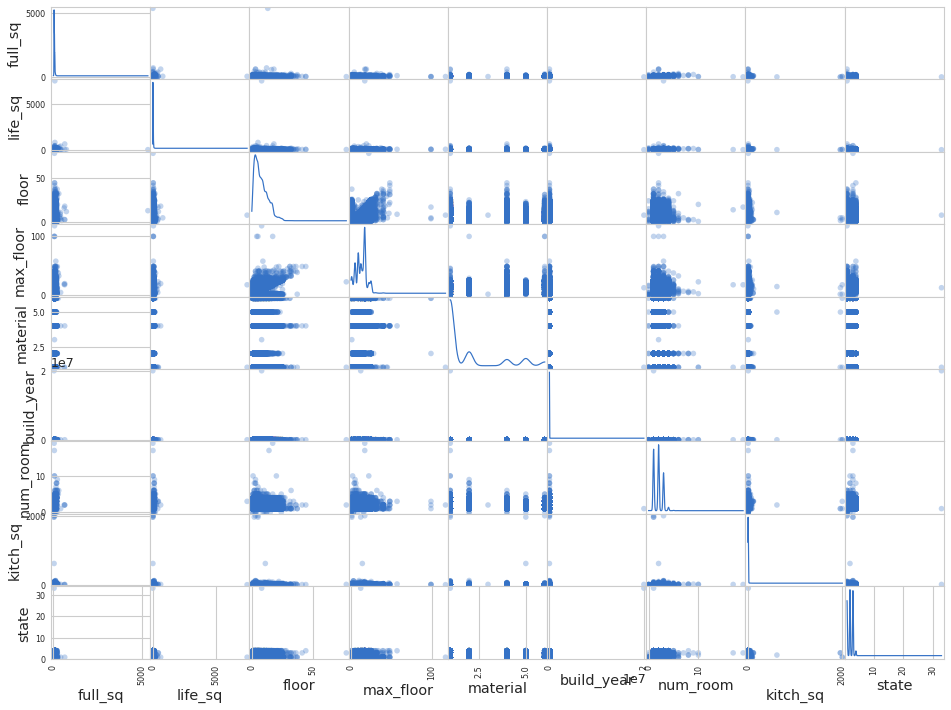

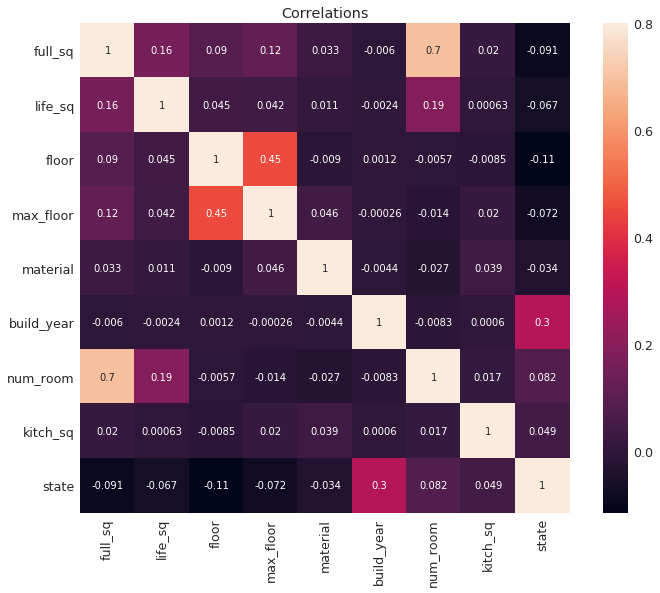

In [12]:
group_housing_features = df_train[['full_sq','life_sq','floor','max_floor','material','build_year','num_room','kitch_sq','state','product_type']]

group_housing_features = (group_housing_features)
corr = group_housing_features.corr()

# Produce a scatter matrix for each pair of features in the data
pd.scatter_matrix(group_housing_features, alpha = 0.3, figsize = (16,12), diagonal = 'kde', marker= 'o');
# Set up the matplotlib figure
f, ax = plt.subplots(figsize=(12, 9))
# Draw the heatmap using seaborn
sns.heatmap(corr, vmax=.8, square=True, annot=True, ax = ax);
ax.set_title('Correlations')
plt.show()

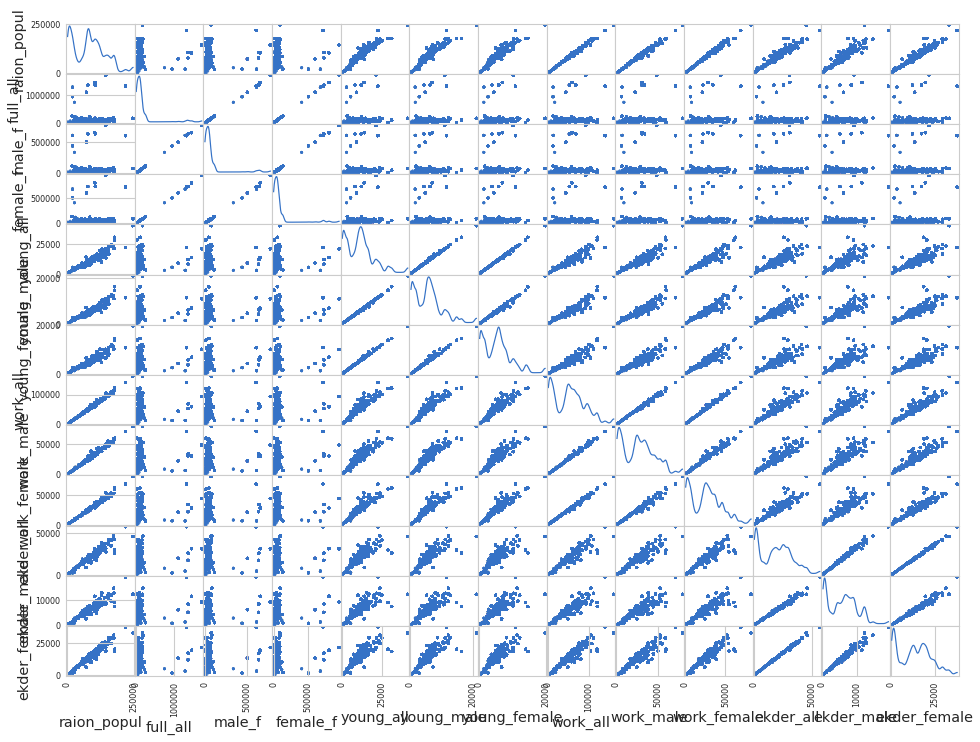

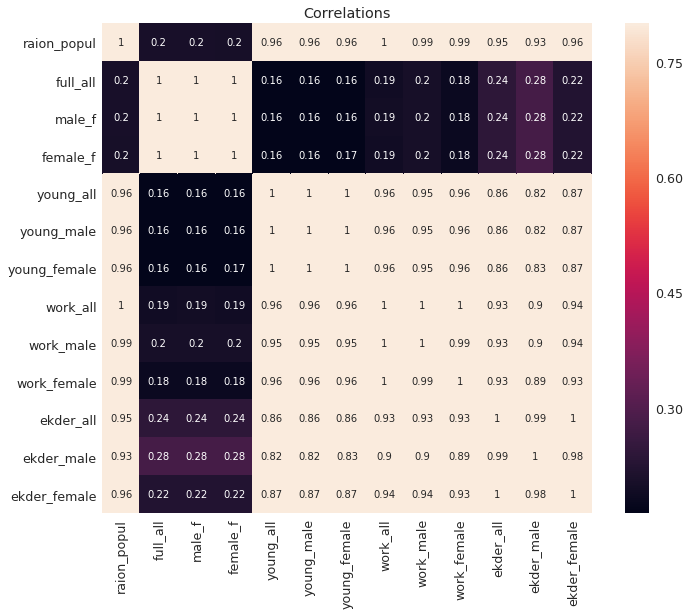

In [13]:
group_population_features = df_train[['raion_popul', 'full_all', 'male_f', 'female_f', 'young_all','young_male', 'young_female', 'work_all', 
                        'work_male', 'work_female', 'ekder_all','ekder_male','ekder_female']]

group_population_features = (group_population_features)
corr = group_population_features.corr()

# Produce a scatter matrix for each pair of features in the data
pd.scatter_matrix(group_population_features, alpha = 0.3, figsize = (16,12), diagonal = 'kde');

# Create  a matplotlib figure for correlation plot
f2, ax2 = plt.subplots(figsize=(12, 9))

# Draw the heatmap using seaborn
sns.heatmap(corr, vmax=.8, square=True,annot=True, ax = ax2);
ax2.set_title('Correlations')
plt.show()

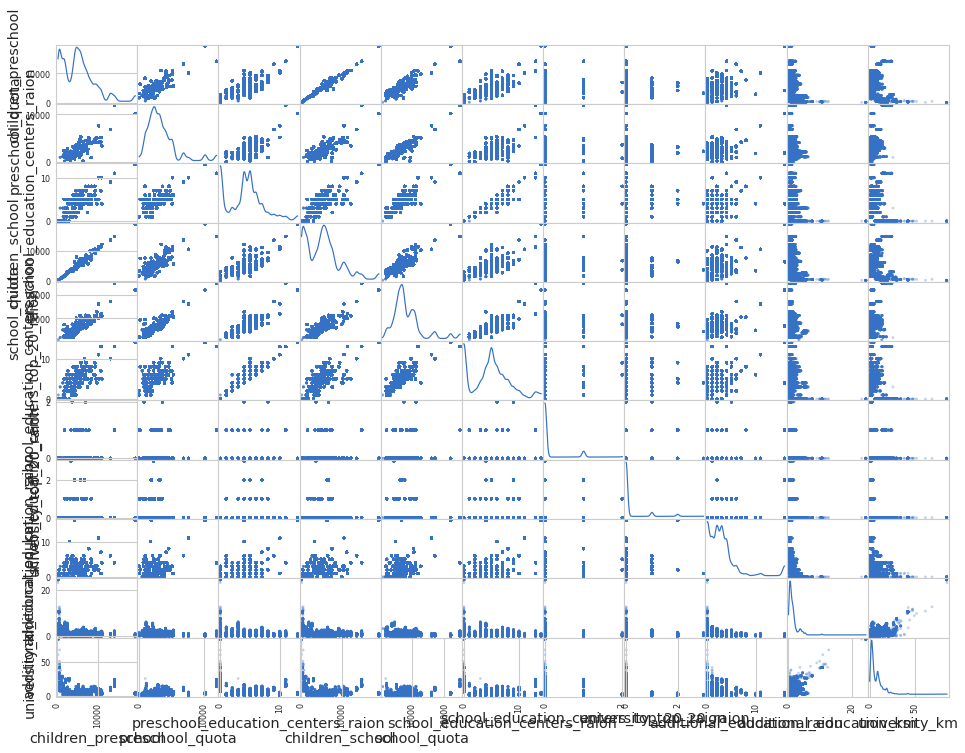

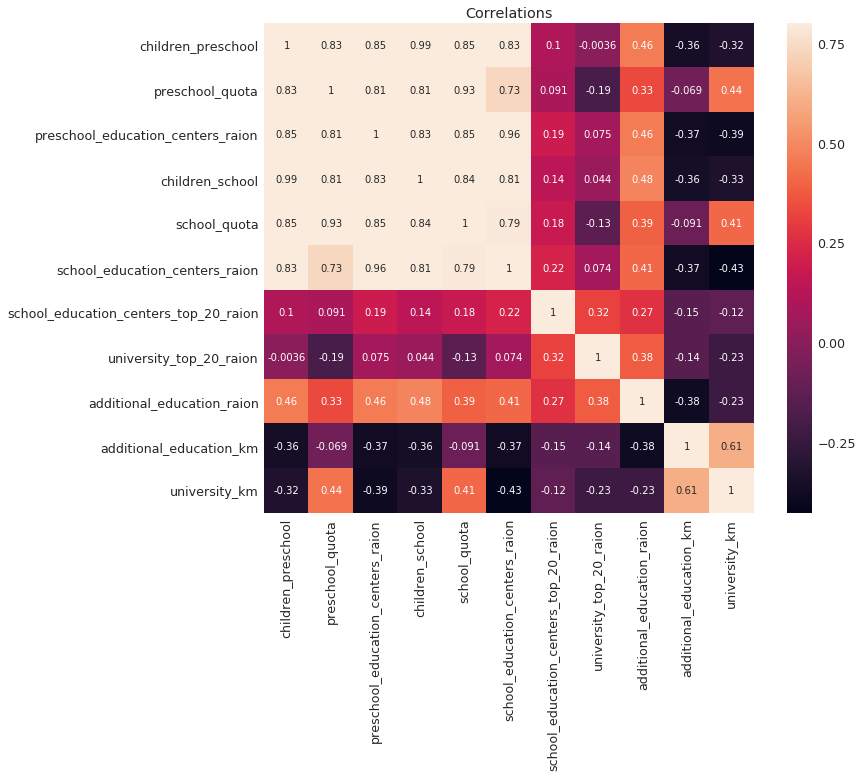

In [14]:
group_education_features = df_train[['children_preschool', 'preschool_quota', 'preschool_education_centers_raion','children_school',
                                     'school_quota', 'school_education_centers_raion', 'school_education_centers_top_20_raion', 
                                     'university_top_20_raion','additional_education_raion', 'additional_education_km', 'university_km',]]

group_education_features = (group_education_features)
corr = group_education_features.corr()

# Produce a scatter matrix for each pair of features in the data
pd.scatter_matrix(group_education_features, alpha = 0.3, figsize = (16,12), diagonal = 'kde');

# Create  a matplotlib figure for correlation plot
f2, ax2 = plt.subplots(figsize=(12, 9))

# Draw the heatmap using seaborn
sns.heatmap(corr, vmax=.8, square=True,annot=True, ax = ax2);
ax2.set_title('Correlations')
plt.show()

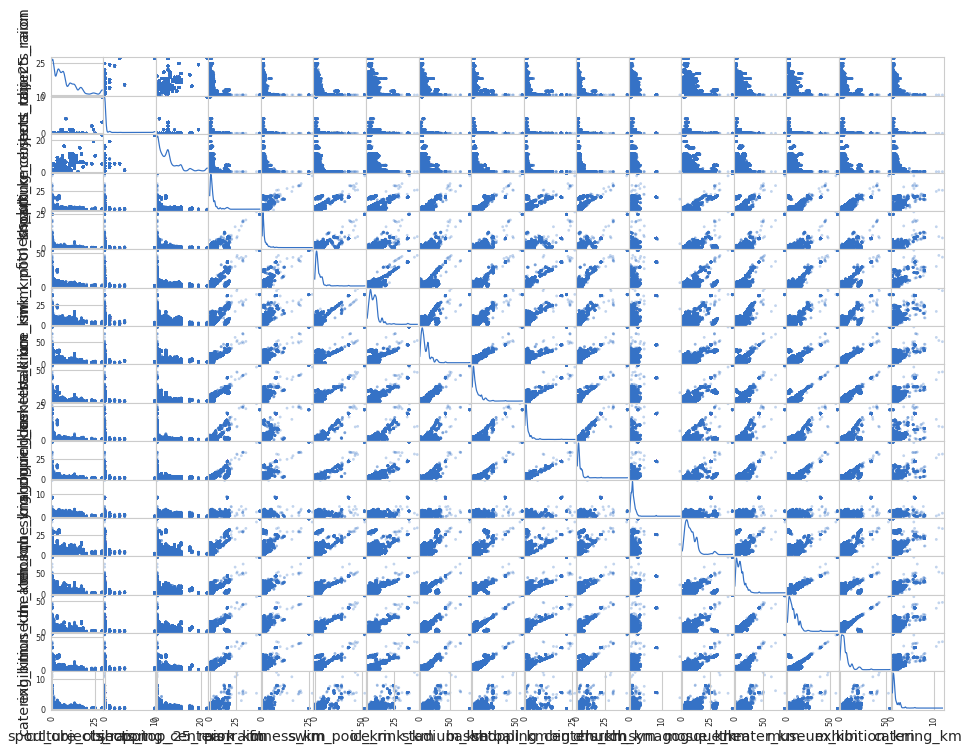

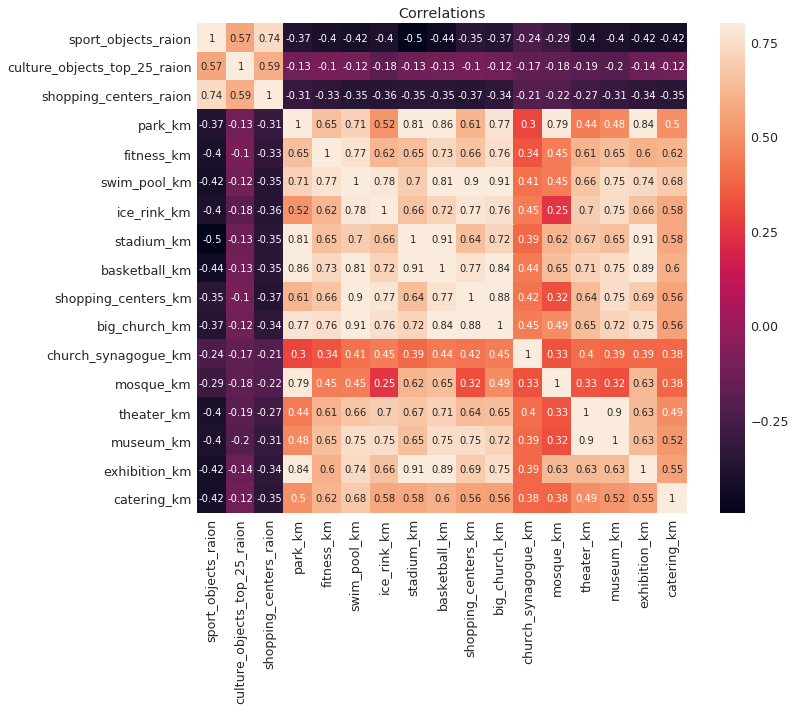

In [15]:
group_cultural_features = df_train[['sport_objects_raion', 'culture_objects_top_25_raion', 'shopping_centers_raion','park_km', 
                                    'fitness_km', 'swim_pool_km', 'ice_rink_km','stadium_km', 'basketball_km','shopping_centers_km', 
                                    'big_church_km','church_synagogue_km', 'mosque_km', 'theater_km','museum_km', 'exhibition_km', 
                                    'catering_km']]

group_cultural_features = (group_cultural_features)
corr = group_cultural_features.corr()

# Produce a scatter matrix for each pair of features in the data
pd.scatter_matrix(group_cultural_features, alpha = 0.3, figsize = (16,12), diagonal = 'kde');

# Create  a matplotlib figure for correlation plot
f2, ax2 = plt.subplots(figsize=(12, 9))

# Draw the heatmap using seaborn
sns.heatmap(corr, vmax=.8, square=True,annot=True, ax = ax2);
ax2.set_title('Correlations')
plt.show()

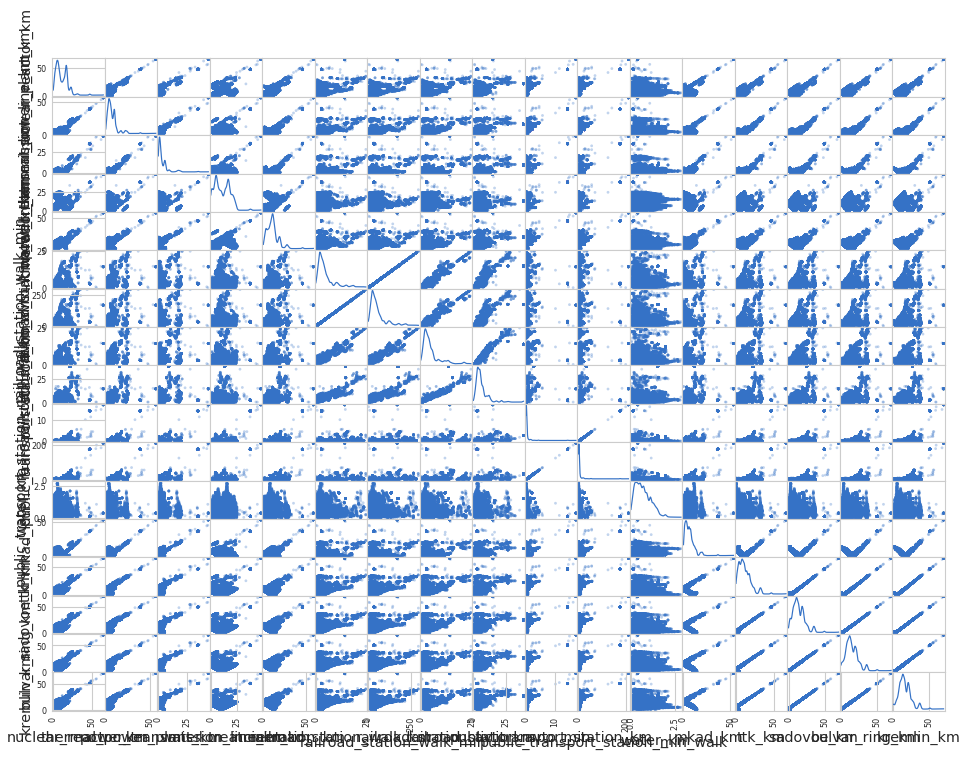

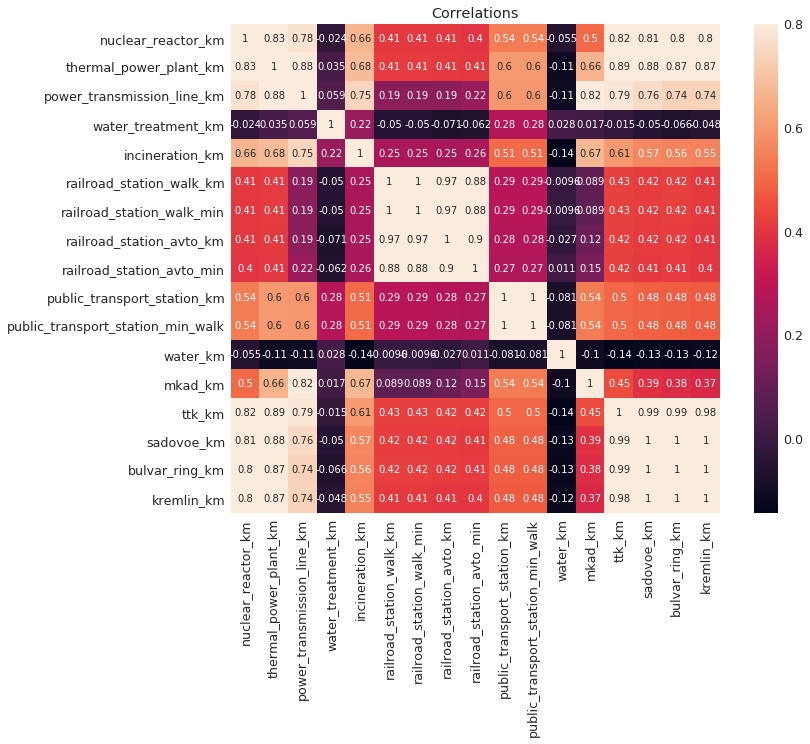

In [16]:
group_urban_features = df_train[['nuclear_reactor_km','thermal_power_plant_km', 'power_transmission_line_km','water_treatment_km', 
                                 'incineration_km', 'railroad_station_walk_km','railroad_station_walk_min', 'railroad_station_avto_km', 
                                 'railroad_station_avto_min','public_transport_station_km', 'public_transport_station_min_walk', 
                                 'water_km','mkad_km', 'ttk_km', 'sadovoe_km','bulvar_ring_km', 'kremlin_km',]]


group_urban_features = (group_urban_features)
corr = group_urban_features.corr()

# Produce a scatter matrix for each pair of features in the data
pd.scatter_matrix(group_urban_features, alpha = 0.3, figsize = (16,12), diagonal = 'kde');

# Create  a matplotlib figure for correlation plot
f2, ax2 = plt.subplots(figsize=(12, 9))

# Draw the heatmap using seaborn
sns.heatmap(corr, vmax=.8, square=True,annot=True, ax = ax2);
ax2.set_title('Correlations')
plt.show()

<a id='wrangle'></a>
### Data Wrangling

count   30471.00000    
mean    7123035.27774  
std     4780111.32963  
min     100000.00000   
25%     4740002.00000  
50%     6274411.00000  
75%     8300000.00000  
max     111111112.00000
Name: price_doc, dtype: float64


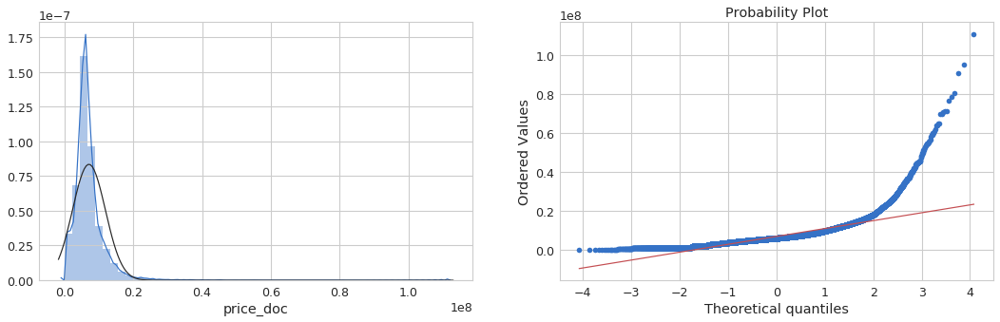

In [17]:
### target variable analysis
target = df_train.price_doc

print(target.describe())  # stats

plt.figure(figsize=(18,5))
plt.subplot(1,2,1)
sns.distplot(target.dropna() , fit=stats.norm);
plt.subplot(1,2,2)
_=stats.probplot(target.dropna(), plot=plt)

count   30471.00000
mean    15.60948   
std     0.60457    
min     11.51293   
25%     15.37155   
50%     15.65199   
75%     15.93177   
max     18.52604   
Name: price_doc, dtype: float64


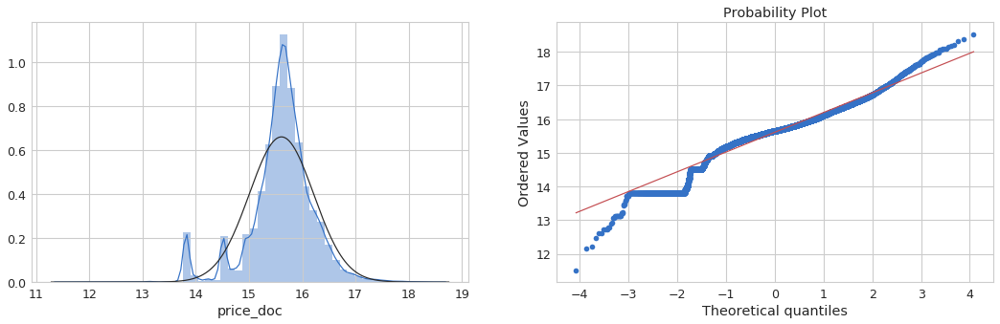

In [18]:
#Log Transform price to improve normality

log_target=np.log(target)
df_train['log_price_doc'] = log_target.values

print(log_target.describe()) # stats

plt.figure(figsize=(18,5))
plt.subplot(1,2,1)
sns.distplot(log_target.dropna() , fit=stats.norm);
plt.subplot(1,2,2)
_=stats.probplot(log_target.dropna(), plot=plt)

In [19]:
# extract transaction year and month
df_train['year_month'] = (df_train.timestamp.dt.month + df_train.timestamp.dt.year * 100)
df_train['year'] = df_train.timestamp.dt.year
df_train['month'] = df_train.timestamp.dt.month

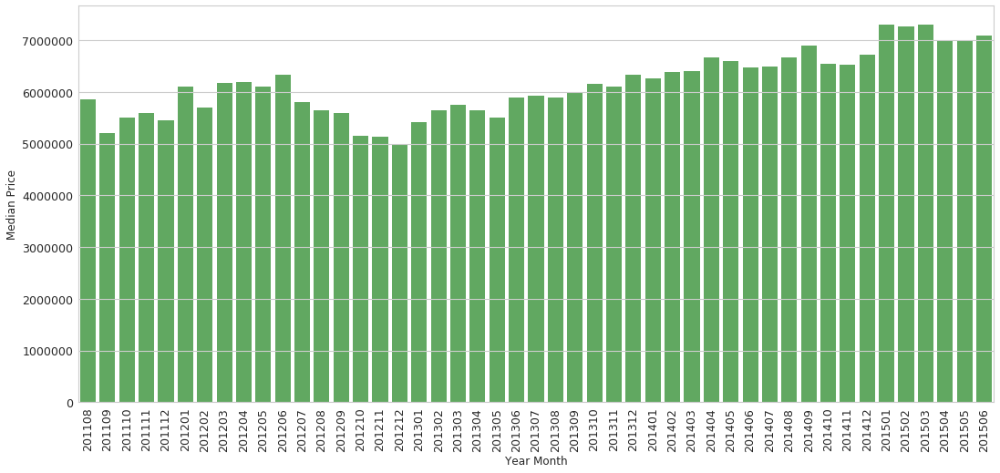

In [20]:
# year month trend
df_grouped = df_train.groupby('year_month')['price_doc'].aggregate(np.median).reset_index()

plt.figure(figsize=(18,8))
sns.barplot(df_grouped.year_month.values, df_grouped.price_doc.values, alpha=0.8, color=color[2])
plt.ylabel('Median Price', fontsize=12)
plt.xlabel('Year Month', fontsize=12)
plt.xticks(rotation='vertical')
plt.show()

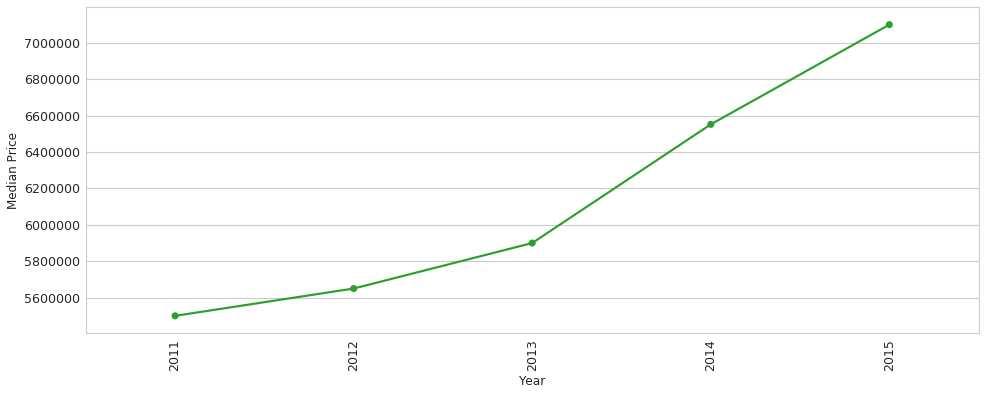

In [21]:
# year trend
df_grouped = df_train.groupby('year')['price_doc'].aggregate(np.median).reset_index()

plt.figure(figsize=(16,6))
sns.pointplot(df_grouped.year.values, df_grouped.price_doc.values, alpha=0.8, color=color[2])
plt.ylabel('Median Price', fontsize=12)
plt.xlabel('Year', fontsize=12)
plt.xticks(rotation='vertical')
plt.show()

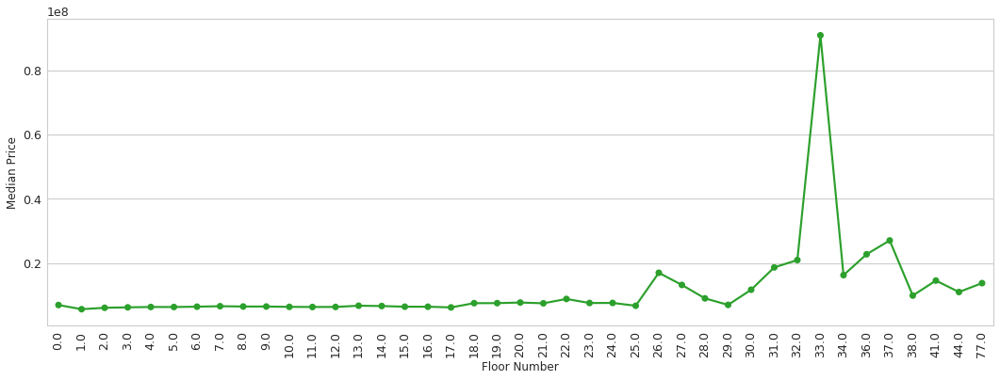

In [22]:
# floor vs price
df_grouped = df_train.groupby('floor')['price_doc'].aggregate(np.median).reset_index()

plt.figure(figsize=(18,6))
sns.pointplot(df_grouped.floor.values, df_grouped.price_doc.values, alpha=0.8, color=color[2])
plt.ylabel('Median Price', fontsize=12)
plt.xlabel('Floor Number', fontsize=12)
plt.xticks(rotation='vertical')
plt.show()

<Figure size 576x576 with 0 Axes>

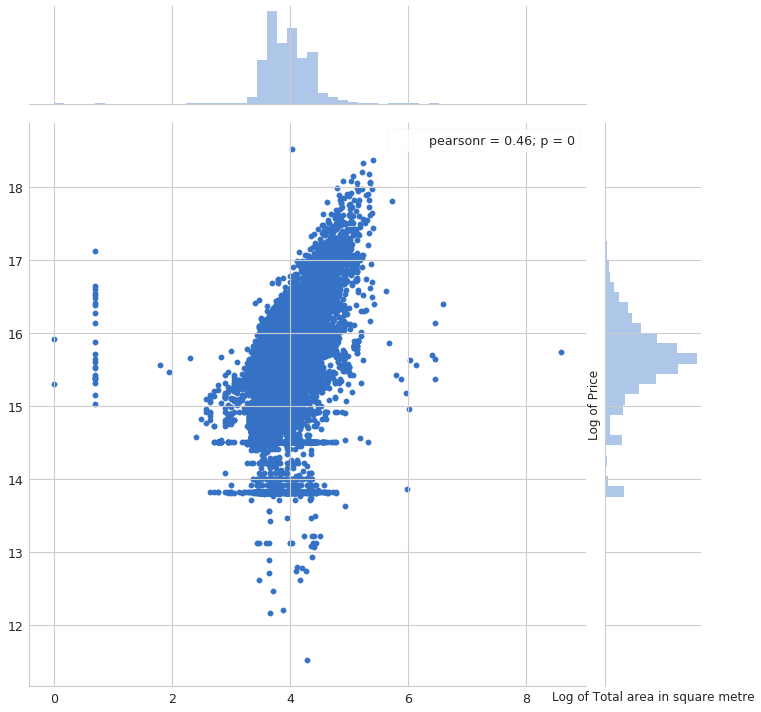

In [23]:
plt.figure(figsize=(8,8))
sns.jointplot(x=np.log1p(df_train.full_sq.values), y=df_train.log_price_doc.values, size=10)
plt.ylabel('Log of Price', fontsize=12)
plt.xlabel('Log of Total area in square metre', fontsize=12)
plt.show()

In [24]:
# edit erronous data points
tmp_dirty_index = df_train[df_train.life_sq > df_train.full_sq].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'life_sq'] = np.NaN

dirty data points: 37
Int64Index([ 1084,  1188,  1822,  1863,  2009,  4385,  6336,  6531,  6993,
             7208,  8101,  9237,  9256,  9482,  9646, 11332, 11711, 11784,
            12569, 13546, 13629, 13797, 14799, 16067, 16116, 16284, 20672,
            21080, 22412, 22611, 22804, 24296, 24428, 26264, 26342, 26363,
            29302],
           dtype='int64')


In [25]:
# edit erronous data points
tmp_dirty_index = df_train[df_train.kitch_sq > df_train.full_sq].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'kitch_sq'] = np.NaN

dirty data points: 12
Int64Index([ 8056,  9172, 10368, 11520, 12245, 13117, 21415, 23216, 26236,
            26850, 28734, 28997],
           dtype='int64')


In [26]:
# edit erronous data points
tmp_dirty_index = df_train[df_train.full_sq<=5].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'full_sq'] = np.NaN

dirty data points: 27
Int64Index([ 2009, 11332, 16289, 16738, 17194, 17932, 18600, 22171, 22412,
            22722, 22795, 22871, 23048, 23228, 23573, 23726, 24296, 24627,
            24892, 25569, 25887, 26264, 26363, 26386, 26582, 26925, 27154],
           dtype='int64')


In [27]:
# edit erronous data points
tmp_dirty_index = df_train[df_train.life_sq<=5].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'life_sq'] = np.NaN

dirty data points: 435
Int64Index([  104,   858,  1596,  2778,  3426,  3800,  4138,  4311,  5879,
             9676,
            ...
            30341, 30353, 30364, 30375, 30391, 30419, 30435, 30441, 30453,
            30458],
           dtype='int64', length=435)


In [28]:
# edit erronous data points
tmp_dirty_index = df_train[df_train.kitch_sq<=1].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'kitch_sq'] = np.NaN

dirty data points: 6235
Int64Index([ 8111,  8144,  8186,  8216,  8268,  8366,  8498,  8499,  8547,
             8618,
            ...
            30449, 30450, 30451, 30453, 30455, 30458, 30459, 30464, 30465,
            30468],
           dtype='int64', length=6235)


In [29]:
# edit erronous floor points
tmp_dirty_index = df_train[df_train.floor > df_train.max_floor].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'floor'] = df_train.ix[tmp_dirty_index, 'max_floor']
#df_train.ix[tmp_dirty_index, 'max_floor']

dirty data points: 1493
Int64Index([ 8216,  8268,  8499,  8531,  8912,  9161,  9257,  9309,  9388,
             9412,
            ...
            30317, 30341, 30353, 30360, 30391, 30398, 30400, 30426, 30439,
            30450],
           dtype='int64', length=1493)


In [30]:
# edit erronous num_room points
tmp_dirty_index = df_train[df_train.num_room == 0].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'num_room'] = np.NaN

dirty data points: 14
Int64Index([10452, 11183, 11791, 15992, 17932, 18123, 18669, 20670, 21439,
            23191, 24043, 24880, 25372, 27454],
           dtype='int64')


In [31]:
cols_with_na = df_train.drop(['price_doc','log_price_doc'],axis=1).isnull().sum()
cols_with_na = cols_with_na[cols_with_na>0]

# fill NaNs with median in that column
for col in cols_with_na.index:
    df_train[col].fillna(df_train[col].median(), inplace=True)

In [32]:
# Verify, no more NaN values apart from price
cols_with_na = df_train.drop(['price_doc','log_price_doc'],axis=1).isnull().sum()
cols_with_na = cols_with_na[cols_with_na>0]
print(cols_with_na.sort_values(ascending=False))

Series([], dtype: int64)


<a id='model'></a>
### Modelling

In [33]:
cols_corr_remove=["young_male", "school_education_centers_top_20_raion", "0_17_female", "railroad_1line", 
                   "7_14_female", "0_17_all", "children_school","ecology","16_29_male", "mosque_count_3000", 
                   "female_f", "church_count_1000","railroad_terminal_raion","mosque_count_5000", "big_road1_1line", 
                   "mosque_count_1000","7_14_male", "0_6_female", "oil_chemistry_raion","young_all", "0_17_male", 
                   "ID_bus_terminal","university_top_20_raion", "mosque_count_500","ID_big_road1","ID_railroad_terminal",
                   "ID_railroad_station_walk", "ID_big_road2", "ID_metro", "ID_railroad_station_avto","0_13_all", 
                   "mosque_count_2000", "work_male", "16_29_all", "young_female", "work_female","0_13_female",
                   "ekder_female", "7_14_all", "big_church_count_500","leisure_count_500", "cafe_sum_1500_max_price_avg", 
                   "leisure_count_2000","office_count_500", "male_f","nuclear_reactor_raion", "0_6_male", 
                   "church_count_500", "build_count_before_1920","thermal_power_plant_raion", "cafe_count_2000_na_price", 
                   "cafe_count_500_price_high","market_count_2000", "trc_count_500", "market_count_1000","work_all", 
                   "additional_education_raion","build_count_slag", "leisure_count_1000", "0_13_male","office_raion",
                   "raion_build_count_with_builddate_info", "market_count_3000", "ekder_all","trc_count_1000", 
                   "build_count_1946-1970","office_count_1500", "cafe_count_1500_na_price","big_church_count_5000", 
                   "big_church_count_1000", "build_count_foam","church_count_1500","church_count_3000", 
                   "leisure_count_1500","16_29_female", "build_count_after_1995", "cafe_avg_price_1500", 
                   "office_sqm_1000", "cafe_avg_price_5000", "cafe_avg_price_2000","big_church_count_1500", 
                   "full_all", "cafe_sum_5000_min_price_avg","office_sqm_2000","church_count_5000","0_6_all", 
                   "detention_facility_raion", "cafe_avg_price_3000","young_male","school_education_centers_top_20_raion", 
                   "0_17_female", "railroad_1line", "7_14_female", "0_17_all","children_school","ecology", "16_29_male", 
                   "mosque_count_3000", "female_f", "church_count_1000","railroad_terminal_raion","mosque_count_5000", 
                   "big_road1_1line", "mosque_count_1000", "7_14_male", "0_6_female", "oil_chemistry_raion","young_all", 
                   "0_17_male", "ID_bus_terminal", "university_top_20_raion","mosque_count_500","ID_big_road1",
                   "ID_railroad_terminal", "ID_railroad_station_walk", "ID_big_road2","ID_metro", 
                   "ID_railroad_station_avto","0_13_all", "mosque_count_2000", "work_male", "16_29_all","young_female", 
                   "work_female", "0_13_female","ekder_female", "7_14_all", "big_church_count_500","leisure_count_500", 
                   "cafe_sum_1500_max_price_avg", "leisure_count_2000","office_count_500","male_f", 
                   "nuclear_reactor_raion", "0_6_male", "church_count_500", "build_count_before_1920",
                   "thermal_power_plant_raion", "cafe_count_2000_na_price", "cafe_count_500_price_high",
                   "market_count_2000","trc_count_500", "market_count_1000", "work_all", "additional_education_raion",
                   "build_count_slag", "leisure_count_1000", "0_13_male", "office_raion",
                   "raion_build_count_with_builddate_info","market_count_3000", "ekder_all", 
                   "trc_count_1000", "build_count_1946-1970","office_count_1500","cafe_count_1500_na_price", 
                   "big_church_count_5000", "big_church_count_1000", "build_count_foam","church_count_1500", 
                   "church_count_3000", "leisure_count_1500","16_29_female", "build_count_after_1995",
                   "cafe_avg_price_1500", "office_sqm_1000", "cafe_avg_price_5000", "cafe_avg_price_2000",
                   "big_church_count_1500","full_all", "cafe_sum_5000_min_price_avg","office_sqm_2000", 
                   "church_count_5000","0_6_all","detention_facility_raion", "cafe_avg_price_3000"]


df_train.drop(cols_corr_remove,axis=1,inplace=True)# drop correlated columns for ML modelling

In [34]:
df_train.head()

,id,timestamp,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,school_quota,school_education_centers_raion,hospital_beds_raion,healthcare_centers_raion,sport_objects_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,incineration_raion,radiation_raion,big_market_raion,ekder_male,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_mix,build_count_1921-1945,build_count_1971-1995,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,railroad_station_avto_km,railroad_station_avto_min,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_sqm_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,sport_count_1000,green_part_1500,prom_part_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,mosque_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,sport_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,leisure_count_3000,sport_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_max_price_avg,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,leisure_count_5000,sport_count_5000,market_count_5000,price_doc,log_price_doc,year_month,year,month
0,1,2011-08-20,43.00000,27.00000,4.00000,12.00000,1.00000,1979.00000,2.00000,8.00000,2.00000,Investment,Bibirevo,6407578.10000,155572,0.18973,0.00007,9576,5001.00000,5,11065.0

In [35]:
#prepare X and Y sets
df_train.drop(['id','timestamp','year_month'],axis=1,inplace=True)# drop unnecessary columns for ML modelling
df_train_x_final=pd.get_dummies(df_train.drop(['price_doc','log_price_doc'],axis=1))
df_train_y_final=df_train.log_price_doc

print(df_train_x_final.shape)
print(df_train_y_final.shape)

(30471, 354)
(30471,)


In [36]:
# define model evaluation metric and function
def fnc_rmse(ground_truth, predictions):
    return np.sqrt(mean_squared_error(ground_truth, predictions)) # get root

rmse_scorer = make_scorer(fnc_rmse, greater_is_better=False)

In [37]:
#initialize a dataframe to store all results
result_log_columns=['model_name','grid_search_score','phase','time']
df_model_train_results=pd.DataFrame(columns=result_log_columns)
df_model_train_results

,model_name,grid_search_score,phase,time


In [38]:
def fnc_train_predict(estimator):
    # fit model
    grid = GridSearchCV(estimator,param_grid,cv=v_num_folds,scoring=rmse_scorer)
    grid.fit(df_train_x_final,df_train_y_final)

    # examine the best model
    print('Best gridsearch score(sqrt):',-grid.best_score_)
    print(grid.best_params_)
    
    tmp_list=[grid.best_estimator_.__class__.__name__
              ,-grid.best_score_,v_iteration_num,datetime.datetime.now()]
    df_model_train_results.loc[len(df_model_train_results)]=tmp_list# store score
    
    return grid.best_estimator_

In [39]:
v_iteration_num='Iteration 1'

In [40]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.6085313968000762
{'fit_intercept': True}
CPU times: user 1min 38s, sys: 1min 41s, total: 3min 19s
Wall time: 4.33 s


In [41]:
%%time
### LassoLars
param_grid = [
  {'alpha':[1e-3,1e-2,1.0,2.0], # default 1.0
   'fit_intercept':[True,False],
   'verbose':[True,False]
  } 
]
estimator=LassoLars() #initialize
est_LassoLars = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.5921167292385668
{'alpha': 2.0, 'fit_intercept': False, 'verbose': True}
CPU times: user 5min, sys: 21min 1s, total: 26min 1s
Wall time: 35.4 s


In [42]:
%%time
# DecisionTreeRegressor
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'min_samples_split':[2,3,4], # default 2
   'min_samples_leaf':[1,2,3], # default 1   
   'max_features':['auto','log2','sqrt'], # default auto
   'max_depth':[5,10,None]
  } 
] 
estimator=DecisionTreeRegressor(random_state=v_random_state) #initialize
est_DecisionTreeRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4950599333716409
{'max_depth': 5, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2}
CPU times: user 5min 12s, sys: 43 s, total: 5min 55s
Wall time: 5min 50s


In [43]:
%%time
# MLPRegressor
param_grid = [
  {
    'alpha':[0.5,1.0],
    'activation':['relu','logistic']
  } 
]
estimator=MLPRegressor(random_state=v_random_state) #initialize
est_MLPRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.6080552857213005
{'activation': 'logistic', 'alpha': 1.0}
CPU times: user 52min 3s, sys: 4h 7min 23s, total: 4h 59min 26s
Wall time: 4min 43s


In [44]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[2,3], # default 3   
   'learning_rate': [.05,0.1], # default 0.1
   'n_estimators':[250,500] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4646127777182306
{'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500}
CPU times: user 2h 59min 1s, sys: 1min 15s, total: 3h 17s
Wall time: 2min 40s


In [45]:
df_model_train_results

,model_name,grid_search_score,phase,time
0,LinearRegression,0.60853,Iteration 1,2019-04-18 14:28:25.605626
1,LassoLars,0.59212,Iteration 1,2019-04-18 14:29:00.987823
2,DecisionTreeRegressor,0.49506,Iteration 1,2019-04-18 14:34:51.862147
3,MLPRegressor,0.60806,Iteration 1,2019-04-18 14:39:35.038870
4,XGBRegressor,0.46461,Iteration 1,2019-04-18 14:42:15.718181


In [46]:
pd.pivot_table(df_model_train_results, values='grid_search_score',index=['phase'], columns='model_name',aggfunc='min')

model_name,DecisionTreeRegressor,LassoLars,LinearRegression,MLPRegressor,XGBRegressor
phase,,,,,
Iteration 1,0.49506,0.59212,0.60853,0.60806,0.46461


Tuning Iteration Phase 2

In [47]:
df_train_after_iter1_bck=df_train.copy()

In [48]:
v_iteration_num='Iteration 2'

In [49]:
df_train.head()

,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,school_quota,school_education_centers_raion,hospital_beds_raion,healthcare_centers_raion,sport_objects_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,incineration_raion,radiation_raion,big_market_raion,ekder_male,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_mix,build_count_1921-1945,build_count_1971-1995,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,railroad_station_avto_km,railroad_station_avto_min,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_sqm_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,sport_count_1000,green_part_1500,prom_part_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,mosque_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,sport_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,leisure_count_3000,sport_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_max_price_avg,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,leisure_count_5000,sport_count_5000,market_count_5000,price_doc,log_price_doc,year,month
0,43.00000,27.00000,4.00000,12.00000,1.00000,1979.00000,2.00000,8.00000,2.00000,Investment,Bibirevo,6407578.10000,155572,0.18973,0.00007,9576,5001.00000,5,11065.00000,5,240.00000,1,7,no,0,16,no,no,no

In [50]:
# analyze built-year data
display(df_train.build_year.describe())
display(df_train[df_train.build_year<1500].build_year.describe())
display(df_train[df_train.build_year>2017].build_year.describe())

count   30471.00000   
mean    2581.80388    
std     114861.56694  
min     0.00000       
25%     1976.00000    
50%     1979.00000    
75%     1983.00000    
max     20052009.00000
Name: build_year, dtype: float64

count   903.00000
mean    0.75305  
std     7.55907  
min     0.00000  
25%     0.00000  
50%     0.00000  
75%     1.00000  
max     215.00000
Name: build_year, dtype: float64

count   3.00000       
mean    6686330.66667 
std     11575017.06927
min     2018.00000    
25%     3491.50000    
50%     4965.00000    
75%     10028487.00000
max     20052009.00000
Name: build_year, dtype: float64

In [51]:
tmp_dirty_index = df_train[df_train.build_year==20052009].index # possible typo error
df_train.ix[tmp_dirty_index, 'build_year'] = 2005

In [52]:
df_train[df_train.build_year>2017]

,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,school_quota,school_education_centers_raion,hospital_beds_raion,healthcare_centers_raion,sport_objects_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,incineration_raion,radiation_raion,big_market_raion,ekder_male,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_mix,build_count_1921-1945,build_count_1971-1995,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,railroad_station_avto_km,railroad_station_avto_min,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_sqm_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,sport_count_1000,green_part_1500,prom_part_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,mosque_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,sport_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,leisure_count_3000,sport_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_max_price_avg,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,leisure_count_5000,sport_count_5000,market_count_5000,price_doc,log_price_doc,year,month
15220,41.00000,24.00000,4.00000,9.00000,2.00000,4965.00000,2.00000,5.00000,3.00000,Investment,Sokolinaja Gora,7905261.32100,85956,0.01493,0.31981,4257,643.00000,4,5180.00000,4,2857.00000,5,14,no,0,8,

In [53]:
# edit erronous build-year points
tmp_dirty_index = df_train[df_train.build_year>2017].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'build_year'] = 2017 # set to max possible value

dirty data points: 2
Int64Index([15220, 29767], dtype='int64')


In [54]:
df_train[df_train.build_year>1500].describe()

,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,school_quota,school_education_centers_raion,hospital_beds_raion,healthcare_centers_raion,sport_objects_raion,culture_objects_top_25_raion,shopping_centers_raion,ekder_male,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_mix,build_count_1921-1945,build_count_1971-1995,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,railroad_station_avto_km,railroad_station_avto_min,public_transport_station_km,public_transport_station_min_walk,water_km,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_sqm_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,sport_count_1000,green_part_1500,prom_part_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,mosque_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,sport_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,leisure_count_3000,sport_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_max_price_avg,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,leisure_count_5000,sport_count_5000,market_count_5000,price_doc,log_price_doc,year,month
count,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29568.00000,29

In [55]:
# edit erronous build-year points
tmp_dirty_index = df_train[df_train.build_year<1500].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'build_year'] = np.NaN 

dirty data points: 903
Int64Index([ 9441,  9620,  9700,  9745,  9764, 10122, 10142, 10260, 10294,
            10329,
            ...
            30330, 30354, 30368, 30377, 30391, 30394, 30425, 30429, 30430,
            30451],
           dtype='int64', length=903)


In [56]:
# edit erronous state points
tmp_dirty_index = df_train[df_train.state > 4].index
print('dirty data points:',len(tmp_dirty_index))
print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'state'] = np.NaN

dirty data points: 1
Int64Index([10089], dtype='int64')


In [57]:
# extract names of numeric columns
dtypes = df_train.dtypes
cols_numeric = dtypes[dtypes != object].index.tolist()

# MSubClass should be treated as categorical
#cols_numeric.remove('MSSubClass')

# choose any numeric column with less than 13 values to be
# "discrete". 13 chosen to include months of the year.
# other columns "continuous"
col_nunique = dict()

for col in cols_numeric:
    col_nunique[col] = df_train[col].nunique()
    
col_nunique = pd.Series(col_nunique)

cols_discrete = col_nunique[col_nunique<13].index.tolist()
cols_continuous = col_nunique[col_nunique>=13].index.tolist()

print(len(cols_numeric),'numeric columns including,\n',
      len(cols_continuous),'are continuous:\n',cols_continuous,'\n',
      len(cols_discrete),'are discrete:\n',cols_discrete)

198 numeric columns including,
 185 are continuous:
 ['full_sq', 'life_sq', 'floor', 'max_floor', 'build_year', 'kitch_sq', 'area_m', 'raion_popul', 'green_zone_part', 'indust_part', 'children_preschool', 'preschool_quota', 'preschool_education_centers_raion', 'school_quota', 'school_education_centers_raion', 'hospital_beds_raion', 'sport_objects_raion', 'shopping_centers_raion', 'ekder_male', 'raion_build_count_with_material_info', 'build_count_block', 'build_count_wood', 'build_count_frame', 'build_count_brick', 'build_count_monolith', 'build_count_panel', 'build_count_1921-1945', 'build_count_1971-1995', 'metro_min_avto', 'metro_km_avto', 'metro_min_walk', 'metro_km_walk', 'kindergarten_km', 'school_km', 'park_km', 'green_zone_km', 'industrial_km', 'water_treatment_km', 'cemetery_km', 'incineration_km', 'railroad_station_walk_km', 'railroad_station_walk_min', 'railroad_station_avto_km', 'railroad_station_avto_min', 'public_transport_station_km', 'public_transport_station_min_walk', 

In [58]:
# extract names of categorical columns
cols_categ = dtypes[~dtypes.index.isin(cols_numeric)].index.tolist()

for col in cols_categ:
    df_train[col] = df_train[col].astype('category')
    
print(len(cols_categ),'categorical columns:\n',cols_categ)

df_train[cols_categ].head()

7 categorical columns:
 ['product_type', 'sub_area', 'culture_objects_top_25', 'incineration_raion', 'radiation_raion', 'big_market_raion', 'water_1line']


,product_type,sub_area,culture_objects_top_25,incineration_raion,radiation_raion,big_market_raion,water_1line
0,Investment,Bibirevo,no,no,no,no,no
1,Investment,Nagatinskij Zaton,yes,no,no,no,no
2,Investment,Tekstil'shhiki,no,no,yes,no,no
3,Investment,Mitino,no,no,no,no,no
4,Investment,Basmannoe,no,no,yes,no,no


In [59]:
# one hot encoding generate so much columns, encode categorical values

#print(df_train['incineration_raion'].value_counts())
df_train['incineration_raion'].replace({'yes':1,'no':0}, inplace=True)

#print(df_train['culture_objects_top_25'].value_counts())
df_train['culture_objects_top_25'].replace({'yes':1,'no':0}, inplace=True)

#print(df_train['radiation_raion'].value_counts())
df_train['radiation_raion'].replace({'yes':1,'no':0}, inplace=True)

#print(df_train['big_market_raion'].value_counts())
df_train['big_market_raion'].replace({'yes':1,'no':0}, inplace=True)

#print(df_train['water_1line'].value_counts())
df_train['water_1line'].replace({'yes':1,'no':0}, inplace=True)

# print(df_train['product_type'].value_counts())
df_train['product_type'].replace({'Investment':2,'OwnerOccupier':1}, inplace=True) # investment is more valuable

In [60]:
cols_with_na = df_train.drop(['price_doc','log_price_doc'],axis=1).isnull().sum()
cols_with_na = cols_with_na[cols_with_na>0]

print(cols_with_na)

# fill NaNs with median in that column
for col in cols_with_na.index:
    df_train[col].fillna(df_train[col].median(), inplace=True)

build_year    903
state         1  
dtype: int64


In [61]:
#prepare X and Y sets
df_train_x_final=pd.get_dummies(df_train.drop(['price_doc','log_price_doc'],axis=1))
df_train_y_final=df_train.log_price_doc

print(df_train_x_final.shape)
print(df_train_y_final.shape)

(30471, 348)
(30471,)


In [62]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.5456645054014796
{'fit_intercept': True}
CPU times: user 1min 38s, sys: 1min 24s, total: 3min 2s
Wall time: 3.49 s


In [63]:
%%time
### LassoLars
param_grid = [
  {'alpha':[1e-3,1e-2,1.0,2.0], # default 1.0
   'fit_intercept':[True,False],
   'verbose':[True,False]
  } 
]
estimator=LassoLars() #initialize
est_LassoLars = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.5621510990370593
{'alpha': 0.001, 'fit_intercept': False, 'verbose': True}
CPU times: user 4min 11s, sys: 17min 24s, total: 21min 35s
Wall time: 28.2 s


In [64]:
%%time
# DecisionTreeRegressor
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'min_samples_split':[2,3,4], # default 2
   'min_samples_leaf':[1,2,3], # default 1   
   'max_features':['auto','log2','sqrt'], # default auto
   'max_depth':[5,10,None]
  } 
] 
estimator=DecisionTreeRegressor(random_state=v_random_state) #initialize
est_DecisionTreeRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4950304256627924
{'max_depth': 5, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 2}
CPU times: user 5min 10s, sys: 5.12 s, total: 5min 15s
Wall time: 5min 10s


In [65]:
%%time
# MLPRegressor
param_grid = [
  {
    'alpha':[0.5,1.0],
    'activation':['relu','logistic']
  } 
]
estimator=MLPRegressor(random_state=v_random_state) #initialize
est_MLPRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.6114132616346593
{'activation': 'logistic', 'alpha': 1.0}
CPU times: user 1h 1min 56s, sys: 4h 54min 8s, total: 5h 56min 4s
Wall time: 5min 35s


In [66]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[2,3], # default 3   
   'learning_rate': [.05,0.1], # default 0.1
   'n_estimators':[250,500] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.46441609008039914
{'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500}
CPU times: user 2h 51min 30s, sys: 60 s, total: 2h 52min 30s
Wall time: 2min 29s


In [67]:
df_model_train_results

,model_name,grid_search_score,phase,time
0,LinearRegression,0.60853,Iteration 1,2019-04-18 14:28:25.605626
1,LassoLars,0.59212,Iteration 1,2019-04-18 14:29:00.987823
2,DecisionTreeRegressor,0.49506,Iteration 1,2019-04-18 14:34:51.862147
3,MLPRegressor,0.60806,Iteration 1,2019-04-18 14:39:35.038870
4,XGBRegressor,0.46461,Iteration 1,2019-04-18 14:42:15.718181
5,LinearRegression,0.54566,Iteration 2,2019-04-18 14:42:20.545113
6,LassoLars,0.56215,Iteration 2,2019-04-18 14:42:48.748009
7,DecisionTreeRegressor,0.49503,Iteration 2,2019-04-18 14:47:59.639204
8,MLPRegressor,0.61141,Iteration 2,2019-04-18 14:53:35.281890
9,XGBRegressor,0.46442,Iteration 2,2019-04-18 14:56:05.146242


In [68]:
pd.pivot_table(df_model_train_results, values='grid_search_score',index=['phase'], columns='model_name',aggfunc='min')

model_name,DecisionTreeRegressor,LassoLars,LinearRegression,MLPRegressor,XGBRegressor
phase,,,,,
Iteration 1,0.49506,0.59212,0.60853,0.60806,0.46461
Iteration 2,0.49503,0.56215,0.54566,0.61141,0.46442


Tuning Iteration Phase 3

In [69]:
df_train_after_iter2_bck=df_train.copy()

In [70]:
#df_train=df_train_after_iter2_bck.copy() # recover

In [71]:
v_iteration_num='Iteration 3'

In [72]:
# calculate age of building at the time of sale
df_train['age']=df_train.year-df_train.build_year
df_train['age'].describe()

count   30471.00000
mean    31.12363   
std     15.41427   
min     -4.00000   
25%     31.00000   
50%     34.00000   
75%     36.00000   
max     323.00000  
Name: age, dtype: float64

In [73]:
df_train[df_train.age<0]

,full_sq,life_sq,floor,max_floor,material,build_year,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,school_quota,school_education_centers_raion,hospital_beds_raion,healthcare_centers_raion,sport_objects_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,incineration_raion,radiation_raion,big_market_raion,ekder_male,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_mix,build_count_1921-1945,build_count_1971-1995,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,railroad_station_avto_km,railroad_station_avto_min,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_sqm_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,sport_count_1000,green_part_1500,prom_part_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,mosque_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,sport_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,leisure_count_3000,sport_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_max_price_avg,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,leisure_count_5000,sport_count_5000,market_count_5000,price_doc,log_price_doc,year,month,age
8153,77.00000,41.00000,2.00000,17.00000,6.00000,2014.00000,3.00000,12.00000,1.00000,1,Poselenie Voskresenskoe,21494094.80000,7122,0.26246,0.01765,489,2854.00000,0,7377.00000,0,990.00000,0,0,0,0,0

In [74]:
# edit erronous age points
tmp_dirty_index = df_train[df_train.build_year>df_train.year].index
print('dirty data points:',len(tmp_dirty_index))
#print(tmp_dirty_index)
df_train.ix[tmp_dirty_index, 'build_year'] = df_train.ix[tmp_dirty_index, 'year']

dirty data points: 1134


In [75]:
# calculate age of building at the time of sale - AGAIN
df_train['age']=(df_train.year-df_train.build_year)+(df_train.month/12.0)
df_train['age'].describe()

count   30471.00000
mean    31.73854   
std     15.30103   
min     0.08333    
25%     31.33333   
50%     34.33333   
75%     36.33333   
max     324.00000  
Name: age, dtype: float64

In [76]:
df_train.drop(['build_year'],axis=1, inplace=True) # no need anymore

In [77]:
# normalise numeric columns using min-max scaler, except sales price
#scale_cols = [col for col in cols_numeric if col not in ('log_price_doc','price_doc')]
scale_cols=['full_sq','life_sq','kitch_sq'] # area_m olmayacak

scaler=MinMaxScaler()
df_train[scale_cols]=scaler.fit_transform(df_train[scale_cols]) # by IY
df_train[scale_cols].describe()

,full_sq,life_sq,kitch_sq
count,30471.00000,30471.00000,30471.00000
mean,0.00907,0.04208,0.05031
std,0.00714,0.02665,0.02436
min,0.00000,0.00000,0.00000
25%,0.00602,0.02540,0.04959
50%,0.00827,0.03651,0.04959
75%,0.01071,0.04921,0.04959
max,1.00000,1.00000,1.00000


In [78]:
df_train.describe()

,full_sq,life_sq,floor,max_floor,material,num_room,kitch_sq,state,product_type,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,school_quota,school_education_centers_raion,hospital_beds_raion,healthcare_centers_raion,sport_objects_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,incineration_raion,radiation_raion,big_market_raion,ekder_male,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_mix,build_count_1921-1945,build_count_1971-1995,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,railroad_station_avto_km,railroad_station_avto_min,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_sqm_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,sport_count_1000,green_part_1500,prom_part_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,mosque_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,sport_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,leisure_count_3000,sport_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_max_price_avg,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,leisure_count_5000,sport_count_5000,market_count_5000,price_doc,log_price_doc,year,month,age
count,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471.00000,30471

In [79]:
#prepare X and Y sets
df_train_x_final=pd.get_dummies(df_train.drop(['price_doc','log_price_doc'],axis=1))
df_train_y_final=df_train.log_price_doc

print(df_train_x_final.shape)
print(df_train_y_final.shape)

(30471, 348)
(30471,)


In [80]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.5456234758850025
{'fit_intercept': True}
CPU times: user 1min 33s, sys: 1min 23s, total: 2min 57s
Wall time: 3.26 s


In [81]:
%%time
### LassoLars
param_grid = [
  {'alpha':[1e-3,1e-2,1.0,2.0], # default 1.0
   'fit_intercept':[True,False],
   'verbose':[True,False]
  } 
]
estimator=LassoLars() #initialize
est_LassoLars = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.5124382553828515
{'alpha': 0.001, 'fit_intercept': False, 'verbose': True}
CPU times: user 4min 8s, sys: 17min 17s, total: 21min 26s
Wall time: 28.1 s


In [82]:
%%time
# BayesianRidge 
param_grid = [
  {'n_iter':[50,100], # default 300 
   'alpha_1':[1e-6,1e-5], # default 1.e-6
   'tol':[1e-5,1e-4,1e-3], # default 1.e-3
   'lambda_1':[1e-7,1e-6,1e-5], #default 1e-6
  } 
]
estimator=BayesianRidge() #initialize
est_BayesianRidge = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.5268372160891922
{'alpha_1': 1e-05, 'lambda_1': 1e-05, 'n_iter': 50, 'tol': 0.001}
CPU times: user 43min 10s, sys: 1h 2min 1s, total: 1h 45min 12s
Wall time: 1min 35s


In [83]:
%%time
# DecisionTreeRegressor
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'min_samples_split':[2,3,4], # default 2
   'min_samples_leaf':[1,2,3], # default 1   
   'max_features':['auto','log2','sqrt'], # default auto
   'max_depth':[5,10,None]
  } 
] 
estimator=DecisionTreeRegressor(random_state=v_random_state) #initialize
est_DecisionTreeRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4950599333716419
{'max_depth': 5, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2}
CPU times: user 5min 9s, sys: 3.81 s, total: 5min 13s
Wall time: 5min 10s


In [84]:
%%time
##### RandomForestRegressor
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'n_estimators':[50,100,250], # default 10   
   'max_features':['auto','log2','sqrt'], # default auto
   'max_depth':[3,7,10,None]
  } 
]
estimator=RandomForestRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_RandomForestRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4775134337839777
{'max_depth': 10, 'max_features': 'auto', 'n_estimators': 250}
CPU times: user 15min 35s, sys: 52.6 s, total: 16min 27s
Wall time: 7min 39s


In [85]:
%%time
# MLPRegressor
param_grid = [
  {
    'alpha':[0.5,1.0],
    'activation':['relu','logistic']
  } 
]
estimator=MLPRegressor(random_state=v_random_state) #initialize
est_MLPRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.6035358152291962
{'activation': 'logistic', 'alpha': 1.0}
CPU times: user 1h 10min 16s, sys: 5h 30min 31s, total: 6h 40min 47s
Wall time: 6min 18s


In [86]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[2,3], # default 3   
   'learning_rate': [.05,0.1], # default 0.1
   'n_estimators':[250,500] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4644320865873622
{'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500}
CPU times: user 3h 6min 12s, sys: 1min 9s, total: 3h 7min 21s
Wall time: 2min 42s


In [87]:
df_model_train_results

,model_name,grid_search_score,phase,time
0,LinearRegression,0.60853,Iteration 1,2019-04-18 14:28:25.605626
1,LassoLars,0.59212,Iteration 1,2019-04-18 14:29:00.987823
2,DecisionTreeRegressor,0.49506,Iteration 1,2019-04-18 14:34:51.862147
3,MLPRegressor,0.60806,Iteration 1,2019-04-18 14:39:35.038870
4,XGBRegressor,0.46461,Iteration 1,2019-04-18 14:42:15.718181
5,LinearRegression,0.54566,Iteration 2,2019-04-18 14:42:20.545113
6,LassoLars,0.56215,Iteration 2,2019-04-18 14:42:48.748009
7,DecisionTreeRegressor,0.49503,Iteration 2,2019-04-18 14:47:59.639204
8,MLPRegressor,0.61141,Iteration 2,2019-04-18 14:53:35.281890
9,XGBRegressor,0.46442,Iteration 2,2019-04-18 14:56:05.146242


In [88]:
pd.pivot_table(df_model_train_results, values='grid_search_score',index=['phase'], columns='model_name',aggfunc='min')

model_name,BayesianRidge,DecisionTreeRegressor,LassoLars,LinearRegression,MLPRegressor,RandomForestRegressor,XGBRegressor
phase,,,,,,,
Iteration 1,nan,0.49506,0.59212,0.60853,0.60806,nan,0.46461
Iteration 2,nan,0.49503,0.56215,0.54566,0.61141,nan,0.46442
Iteration 3,0.52684,0.49506,0.51244,0.54562,0.60354,0.47751,0.46443


Tuning Iteration Phase 4

In [89]:
df_train_after_iter3_bck=df_train.copy()

In [90]:
#df_train=df_train_after_iter2_bck.copy() # recover

In [91]:
v_iteration_num='Iteration 4'

In [92]:
df_train.head()

,full_sq,life_sq,floor,max_floor,material,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,school_quota,school_education_centers_raion,hospital_beds_raion,healthcare_centers_raion,sport_objects_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,incineration_raion,radiation_raion,big_market_raion,ekder_male,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_mix,build_count_1921-1945,build_count_1971-1995,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,railroad_station_avto_km,railroad_station_avto_min,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_sqm_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,sport_count_1000,green_part_1500,prom_part_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,mosque_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,sport_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,leisure_count_3000,sport_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_max_price_avg,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,leisure_count_5000,sport_count_5000,market_count_5000,price_doc,log_price_doc,year,month,age
0,0.00695,0.03175,4.00000,12.00000,1.00000,2.00000,0.04959,2.00000,2,Bibirevo,6407578.10000,155572,0.18973,0.00007,9576,5001.00000,5,11065.00000,5,240.00000,1,7,0,0,16,0,0,0,10580,211.00000,25.00000,0.00000

In [93]:
cols_continuous

['full_sq',
 'life_sq',
 'floor',
 'max_floor',
 'build_year',
 'kitch_sq',
 'area_m',
 'raion_popul',
 'green_zone_part',
 'indust_part',
 'children_preschool',
 'preschool_quota',
 'preschool_education_centers_raion',
 'school_quota',
 'school_education_centers_raion',
 'hospital_beds_raion',
 'sport_objects_raion',
 'shopping_centers_raion',
 'ekder_male',
 'raion_build_count_with_material_info',
 'build_count_block',
 'build_count_wood',
 'build_count_frame',
 'build_count_brick',
 'build_count_monolith',
 'build_count_panel',
 'build_count_1921-1945',
 'build_count_1971-1995',
 'metro_min_avto',
 'metro_km_avto',
 'metro_min_walk',
 'metro_km_walk',
 'kindergarten_km',
 'school_km',
 'park_km',
 'green_zone_km',
 'industrial_km',
 'water_treatment_km',
 'cemetery_km',
 'incineration_km',
 'railroad_station_walk_km',
 'railroad_station_walk_min',
 'railroad_station_avto_km',
 'railroad_station_avto_min',
 'public_transport_station_km',
 'public_transport_station_min_walk',
 'water_

In [94]:
#Check effect of Box-Cox and Log transforms on distributions of continuous variables
fea_target='log_price_doc'
fcols = 9
frows = len(cols_continuous)-1
plt.figure(figsize=(4*fcols,4*frows))
i=0

for var in cols_continuous:
    if var not in ('price_doc','log_price_doc','build_year','area_m','cafe_sum_500_min_price_avg','cafe_avg_price_500'
                   ,'cafe_sum_2000_min_price_avg','cafe_sum_2000_max_price_avg','cafe_sum_3000_min_price_avg'
                   ,'cafe_sum_3000_max_price_avg','cafe_sum_5000_max_price_avg'):
        dat = df_train[[var, fea_target]].dropna()
        #print(var)
        
        i+=1 #original
        plt.subplot(frows,fcols,i)
        sns.distplot(dat[var] , fit=stats.norm);
        plt.title(var+' Original')
        plt.xlabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        _=stats.probplot(dat[var], plot=plt)
        plt.title('skew='+'{:.4f}'.format(stats.skew(dat[var])))
        plt.xlabel('')
        plt.ylabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        plt.plot(dat[var], dat[fea_target],'.',alpha=0.5)
        plt.title('corr='+'{:.2f}'.format(np.corrcoef(dat[var], dat[fea_target])[0][1]))
 
        i+=1 # boxcox transform
        plt.subplot(frows,fcols,i)
        trans_var, lambda_var = stats.boxcox(dat[var].dropna()+1)
        trans_var = minmax_scale(trans_var)      
        sns.distplot(trans_var , fit=stats.norm);
        plt.title(var+' Boxcox Transformed')
        plt.xlabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        _=stats.probplot(trans_var, plot=plt)
        plt.title('skew='+'{:.4f}'.format(stats.skew(trans_var)))
        plt.xlabel('')
        plt.ylabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        plt.plot(trans_var, dat[fea_target],'.',alpha=0.5)
        plt.title('corr='+'{:.2f}'.format(np.corrcoef(trans_var,dat[fea_target])[0][1]))
        
        i+=1 #log transform
        plt.subplot(frows,fcols,i)
        trans_var = np.log(dat[var].dropna()+1)
        trans_var = minmax_scale(trans_var)
        sns.distplot(trans_var , fit=stats.norm);
        plt.title(var+' Log Transformed')
        plt.xlabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        _=stats.probplot(trans_var, plot=plt)
        plt.title('skew='+'{:.4f}'.format(stats.skew(trans_var)))
        plt.xlabel('')
        plt.ylabel('')
        
        i+=1
        plt.subplot(frows,fcols,i)
        plt.plot(trans_var, dat[fea_target],'.',alpha=0.5)
        plt.title('corr='+'{:.2f}'.format(np.corrcoef(trans_var,dat[fea_target])[0][1]))

In [95]:
# variables not suitable for box-cox transformation based on above (usually due to excessive zeros)
cols_notransform = ['price_doc','log_price_doc','build_year','area_m','cafe_sum_500_min_price_avg','cafe_avg_price_500'
                    ,'cafe_sum_2000_min_price_avg','cafe_sum_2000_max_price_avg','cafe_sum_3000_min_price_avg'
                    ,'cafe_sum_3000_max_price_avg','cafe_sum_5000_max_price_avg'
                    ,'build_count_frame','office_sqm_500','trc_sqm_500','cafe_count_500_na_price'
                    ,'cafe_count_500_price_2500','cafe_count_500_price_4000','cafe_count_1000_price_4000'
                    ,'cafe_count_1500_price_4000','cafe_count_1500_price_high','cafe_count_2000_price_high'
                    ,'cafe_count_3000_price_high']

cols_transform = [col for col in cols_continuous if col not in cols_notransform]

#transform remaining variables
#print('Transforming',len(cols_transform),'columns:',cols_transform)

for col in cols_transform:   
    # transform column
    df_train.loc[:,col], _ = stats.boxcox(df_train.loc[:,col]+1)
    
    # renormalise column after boxcox transform
    df_train.loc[:,col] = minmax_scale(df_train.loc[:,col])

In [96]:
#prepare X and Y sets
df_train_x_final=pd.get_dummies(df_train.drop(['price_doc','log_price_doc'],axis=1))
df_train_y_final=df_train.log_price_doc

print(df_train_x_final.shape)
print(df_train_y_final.shape)

(30471, 348)
(30471,)


In [97]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4710984676696797
{'fit_intercept': True}
CPU times: user 1min 38s, sys: 1min 15s, total: 2min 53s
Wall time: 2.96 s


In [98]:
%%time
### LassoLars
param_grid = [
  {'alpha':[1e-3,1e-2,1.0,2.0], # default 1.0
   'fit_intercept':[True,False],
   'verbose':[True,False]
  } 
]
estimator=LassoLars() #initialize
est_LassoLars = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.48184943988982615
{'alpha': 0.001, 'fit_intercept': False, 'verbose': True}
CPU times: user 3min 4s, sys: 12min 55s, total: 15min 59s
Wall time: 20.6 s


In [99]:
%%time
# BayesianRidge 
param_grid = [
  {'n_iter':[50,100], # default 300 
   'alpha_1':[1e-6,1e-5], # default 1.e-6
   'tol':[1e-5,1e-4,1e-3], # default 1.e-3
   'lambda_1':[1e-7,1e-6,1e-5], #default 1e-6
  } 
]
estimator=BayesianRidge() #initialize
est_BayesianRidge = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4705317651533094
{'alpha_1': 1e-06, 'lambda_1': 1e-05, 'n_iter': 50, 'tol': 1e-05}
CPU times: user 40min 28s, sys: 48min 13s, total: 1h 28min 42s
Wall time: 1min 17s


In [100]:
%%time
# DecisionTreeRegressor
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'min_samples_split':[2,3,4], # default 2
   'min_samples_leaf':[1,2,3], # default 1   
   'max_features':['auto','log2','sqrt'], # default auto
   'max_depth':[5,10,None]
  } 
] 
estimator=DecisionTreeRegressor(random_state=v_random_state) #initialize
est_DecisionTreeRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4950878005829059
{'max_depth': 5, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2}
CPU times: user 5min 17s, sys: 5.99 s, total: 5min 23s
Wall time: 5min 14s


In [101]:
%%time
##### RandomForestRegressor
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'n_estimators':[50,100,250], # default 10   
   'max_features':['auto','log2','sqrt'], # default auto
   'max_depth':[3,7,10,None]
  } 
]
estimator=RandomForestRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_RandomForestRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.477421769156505
{'max_depth': 10, 'max_features': 'auto', 'n_estimators': 250}
CPU times: user 15min 28s, sys: 1min 1s, total: 16min 30s
Wall time: 7min 47s


In [102]:
%%time
# MLPRegressor
param_grid = [
  {
    'alpha':[0.5,1.0],
    'activation':['relu','logistic']
  } 
]
estimator=MLPRegressor(random_state=v_random_state) #initialize
est_MLPRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.6063828515458964
{'activation': 'logistic', 'alpha': 0.5}
CPU times: user 30min 39s, sys: 2h 19min, total: 2h 49min 40s
Wall time: 2min 40s


In [103]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[2,3], # default 3   
   'learning_rate': [.05,0.1], # default 0.1
   'n_estimators':[250,500] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.46441694348971707
{'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500}
CPU times: user 3h 7min 11s, sys: 25.5 s, total: 3h 7min 36s
Wall time: 2min 30s


In [104]:
df_model_train_results

,model_name,grid_search_score,phase,time
0,LinearRegression,0.60853,Iteration 1,2019-04-18 14:28:25.605626
1,LassoLars,0.59212,Iteration 1,2019-04-18 14:29:00.987823
2,DecisionTreeRegressor,0.49506,Iteration 1,2019-04-18 14:34:51.862147
3,MLPRegressor,0.60806,Iteration 1,2019-04-18 14:39:35.038870
4,XGBRegressor,0.46461,Iteration 1,2019-04-18 14:42:15.718181
5,LinearRegression,0.54566,Iteration 2,2019-04-18 14:42:20.545113
6,LassoLars,0.56215,Iteration 2,2019-04-18 14:42:48.748009
7,DecisionTreeRegressor,0.49503,Iteration 2,2019-04-18 14:47:59.639204
8,MLPRegressor,0.61141,Iteration 2,2019-04-18 14:53:35.281890
9,XGBRegressor,0.46442,Iteration 2,2019-04-18 14:56:05.146242


In [105]:
pd.pivot_table(df_model_train_results, values='grid_search_score',index=['phase'], columns='model_name',aggfunc='min')

model_name,BayesianRidge,DecisionTreeRegressor,LassoLars,LinearRegression,MLPRegressor,RandomForestRegressor,XGBRegressor
phase,,,,,,,
Iteration 1,nan,0.49506,0.59212,0.60853,0.60806,nan,0.46461
Iteration 2,nan,0.49503,0.56215,0.54566,0.61141,nan,0.46442
Iteration 3,0.52684,0.49506,0.51244,0.54562,0.60354,0.47751,0.46443
Iteration 4,0.47053,0.49509,0.48185,0.47110,0.60638,0.47742,0.46442


Tuning Iteration Phase 5

In [106]:
df_train_after_iter4_bck=df_train.copy()

In [107]:
#df_train=df_train_after_iter2_bck.copy() # recover

In [108]:
v_iteration_num='Iteration 5'

In [109]:
df_train.head()

,full_sq,life_sq,floor,max_floor,material,num_room,kitch_sq,state,product_type,sub_area,area_m,raion_popul,green_zone_part,indust_part,children_preschool,preschool_quota,preschool_education_centers_raion,school_quota,school_education_centers_raion,hospital_beds_raion,healthcare_centers_raion,sport_objects_raion,culture_objects_top_25,culture_objects_top_25_raion,shopping_centers_raion,incineration_raion,radiation_raion,big_market_raion,ekder_male,raion_build_count_with_material_info,build_count_block,build_count_wood,build_count_frame,build_count_brick,build_count_monolith,build_count_panel,build_count_mix,build_count_1921-1945,build_count_1971-1995,metro_min_avto,metro_km_avto,metro_min_walk,metro_km_walk,kindergarten_km,school_km,park_km,green_zone_km,industrial_km,water_treatment_km,cemetery_km,incineration_km,railroad_station_walk_km,railroad_station_walk_min,railroad_station_avto_km,railroad_station_avto_min,public_transport_station_km,public_transport_station_min_walk,water_km,water_1line,mkad_km,ttk_km,sadovoe_km,bulvar_ring_km,kremlin_km,big_road1_km,big_road2_km,railroad_km,zd_vokzaly_avto_km,bus_terminal_avto_km,oil_chemistry_km,nuclear_reactor_km,radiation_km,power_transmission_line_km,thermal_power_plant_km,ts_km,big_market_km,market_shop_km,fitness_km,swim_pool_km,ice_rink_km,stadium_km,basketball_km,hospice_morgue_km,detention_facility_km,public_healthcare_km,university_km,workplaces_km,shopping_centers_km,office_km,additional_education_km,preschool_km,big_church_km,church_synagogue_km,mosque_km,theater_km,museum_km,exhibition_km,catering_km,green_part_500,prom_part_500,office_sqm_500,trc_sqm_500,cafe_count_500,cafe_sum_500_min_price_avg,cafe_sum_500_max_price_avg,cafe_avg_price_500,cafe_count_500_na_price,cafe_count_500_price_500,cafe_count_500_price_1000,cafe_count_500_price_1500,cafe_count_500_price_2500,cafe_count_500_price_4000,sport_count_500,market_count_500,green_part_1000,prom_part_1000,office_count_1000,trc_sqm_1000,cafe_count_1000,cafe_sum_1000_min_price_avg,cafe_sum_1000_max_price_avg,cafe_avg_price_1000,cafe_count_1000_na_price,cafe_count_1000_price_500,cafe_count_1000_price_1000,cafe_count_1000_price_1500,cafe_count_1000_price_2500,cafe_count_1000_price_4000,cafe_count_1000_price_high,sport_count_1000,green_part_1500,prom_part_1500,office_sqm_1500,trc_count_1500,trc_sqm_1500,cafe_count_1500,cafe_sum_1500_min_price_avg,cafe_count_1500_price_500,cafe_count_1500_price_1000,cafe_count_1500_price_1500,cafe_count_1500_price_2500,cafe_count_1500_price_4000,cafe_count_1500_price_high,mosque_count_1500,sport_count_1500,market_count_1500,green_part_2000,prom_part_2000,office_count_2000,trc_count_2000,trc_sqm_2000,cafe_count_2000,cafe_sum_2000_min_price_avg,cafe_sum_2000_max_price_avg,cafe_count_2000_price_500,cafe_count_2000_price_1000,cafe_count_2000_price_1500,cafe_count_2000_price_2500,cafe_count_2000_price_4000,cafe_count_2000_price_high,big_church_count_2000,church_count_2000,sport_count_2000,green_part_3000,prom_part_3000,office_count_3000,office_sqm_3000,trc_count_3000,trc_sqm_3000,cafe_count_3000,cafe_sum_3000_min_price_avg,cafe_sum_3000_max_price_avg,cafe_count_3000_na_price,cafe_count_3000_price_500,cafe_count_3000_price_1000,cafe_count_3000_price_1500,cafe_count_3000_price_2500,cafe_count_3000_price_4000,cafe_count_3000_price_high,big_church_count_3000,leisure_count_3000,sport_count_3000,green_part_5000,prom_part_5000,office_count_5000,office_sqm_5000,trc_count_5000,trc_sqm_5000,cafe_count_5000,cafe_sum_5000_max_price_avg,cafe_count_5000_na_price,cafe_count_5000_price_500,cafe_count_5000_price_1000,cafe_count_5000_price_1500,cafe_count_5000_price_2500,cafe_count_5000_price_4000,cafe_count_5000_price_high,leisure_count_5000,sport_count_5000,market_count_5000,price_doc,log_price_doc,year,month,age
0,0.57874,0.51990,0.31587,0.14334,1.00000,2.00000,0.55291,2.00000,2,Bibirevo,6407578.10000,0.75390,0.46486,0.00041,0.69231,0.68961,0.49832,0.73835,0.47024,0.24547,1,0.53233,0,0,0.88934,0,0,0,0.69799,0.35572

In [110]:
#prepare X and Y sets
df_train_x_final=pd.get_dummies(df_train.drop(['price_doc','log_price_doc'],axis=1))
df_train_y_final=df_train.log_price_doc

print(df_train_x_final.shape)
print(df_train_y_final.shape)

(30471, 348)
(30471,)


In [121]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4710984676696797
{'fit_intercept': True}
CPU times: user 1min 31s, sys: 1min 21s, total: 2min 53s
Wall time: 2.81 s


In [122]:
%%time
### LassoLars
param_grid = [
  {'alpha':[5e-5,1e-5,1e-4], # default 1.0
   'fit_intercept':[True,False],
   'verbose':[True,False]
  } 
]
estimator=LassoLars() #initialize
est_LassoLars = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.47042735972693817
{'alpha': 1e-05, 'fit_intercept': True, 'verbose': True}
CPU times: user 5min 47s, sys: 23min 54s, total: 29min 42s
Wall time: 32.4 s


In [123]:
%%time
# BayesianRidge 
param_grid = [
  {'n_iter':[10,25,50], # default 300 
   'alpha_1':[1e-8,1e-7,1e-6], # default 1.e-6
   'tol':[5e-3,1e-3,1e-2], # default 1.e-3
   'lambda_1':[1e-7,1e-6,1e-5], #default 1e-6
  } 
]
estimator=BayesianRidge() #initialize
est_BayesianRidge = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4705317651938417
{'alpha_1': 1e-08, 'lambda_1': 1e-05, 'n_iter': 10, 'tol': 0.001}
CPU times: user 1h 31min 35s, sys: 1h 46min 49s, total: 3h 18min 24s
Wall time: 2min 53s


In [124]:
%%time
# DecisionTreeRegressor
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'min_samples_split':[2,3], # default 2
   'min_samples_leaf':[1,2,3], # default 1   
   'max_features':['auto','log2','sqrt'], # default auto
   'max_depth':[5,6,7,None]
  } 
] 
estimator=DecisionTreeRegressor(random_state=v_random_state) #initialize
est_DecisionTreeRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4947168122438927
{'max_depth': 6, 'max_features': 'auto', 'min_samples_leaf': 3, 'min_samples_split': 2}
CPU times: user 3min 57s, sys: 6.18 s, total: 4min 3s
Wall time: 3min 54s


In [125]:
%%time
##### RandomForestRegressor
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'n_estimators':[1000,1250], # default 10   
   'max_features':['auto','log2','sqrt'], # default auto
   'max_depth':[10,12,14]
  } 
]
estimator=RandomForestRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_RandomForestRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.47696434416344774
{'max_depth': 12, 'max_features': 'auto', 'n_estimators': 1250}
CPU times: user 1h 23min 31s, sys: 1min 54s, total: 1h 25min 26s
Wall time: 25min 29s


In [126]:
%%time
# MLPRegressor
param_grid = [
  {
    'alpha':[0.4,0.5,0.6],
    'activation':['relu','logistic']
  } 
]
estimator=MLPRegressor(random_state=v_random_state) #initialize
est_MLPRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.6063828515458964
{'activation': 'logistic', 'alpha': 0.5}
CPU times: user 42min 1s, sys: 3h 10min 7s, total: 3h 52min 9s
Wall time: 3min 38s


In [127]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[3,4], # default 3   
   'learning_rate': [.01,.05], # default 0.1
   'subsample':[0.8,0.9],
   'colsample_bytree':[0.85,0.9],
   'n_estimators':[500,600] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4639441411784834
{'colsample_bytree': 0.85, 'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
CPU times: user 4d 1h 15min 14s, sys: 14min 10s, total: 4d 1h 29min 25s
Wall time: 1h 17min 31s


In [128]:
df_model_train_results

,model_name,grid_search_score,phase,time
0,LinearRegression,0.60853,Iteration 1,2019-04-18 14:28:25.605626
1,LassoLars,0.59212,Iteration 1,2019-04-18 14:29:00.987823
2,DecisionTreeRegressor,0.49506,Iteration 1,2019-04-18 14:34:51.862147
3,MLPRegressor,0.60806,Iteration 1,2019-04-18 14:39:35.038870
4,XGBRegressor,0.46461,Iteration 1,2019-04-18 14:42:15.718181
5,LinearRegression,0.54566,Iteration 2,2019-04-18 14:42:20.545113
6,LassoLars,0.56215,Iteration 2,2019-04-18 14:42:48.748009
7,DecisionTreeRegressor,0.49503,Iteration 2,2019-04-18 14:47:59.639204
8,MLPRegressor,0.61141,Iteration 2,2019-04-18 14:53:35.281890
9,XGBRegressor,0.46442,Iteration 2,2019-04-18 14:56:05.146242


In [129]:
pd.pivot_table(df_model_train_results, values='grid_search_score',index=['phase'], columns='model_name',aggfunc='min')

model_name,BayesianRidge,DecisionTreeRegressor,LassoLars,LinearRegression,MLPRegressor,RandomForestRegressor,XGBRegressor
phase,,,,,,,
Iteration 1,nan,0.49506,0.59212,0.60853,0.60806,nan,0.46461
Iteration 2,nan,0.49503,0.56215,0.54566,0.61141,nan,0.46442
Iteration 3,0.52684,0.49506,0.51244,0.54562,0.60354,0.47751,0.46443
Iteration 4,0.47053,0.49509,0.48185,0.47110,0.60638,0.47742,0.46442
Iteration 5,0.47053,0.49472,0.47043,0.47110,0.60638,0.47696,0.46394


Tuning Iteration Phase 6

In [137]:
df_train_after_iter5_bck=df_train.copy()

In [139]:
#df_train=df_train_after_iter5_bck.copy() # recover

In [140]:
v_iteration_num='Iteration 6'

In [143]:
#prepare X and Y sets
df_train_x_final=pd.get_dummies(df_train.drop(['price_doc','log_price_doc'],axis=1))
df_train_y_final=df_train.log_price_doc

print(df_train_x_final.shape)
print(df_train_y_final.shape)

(30471, 348)
(30471,)


In [149]:
v_num_folds=3

In [150]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4765447021461702
{'fit_intercept': True}
CPU times: user 56.8 s, sys: 42.6 s, total: 1min 39s
Wall time: 1.66 s


In [151]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[3,4], # default 3   
   'learning_rate': [.01,.05], # default 0.1
   'subsample':[0.8,0.9],
   'colsample_bytree':[0.85,0.9],
   'n_estimators':[500,600] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4722275612101976
{'colsample_bytree': 0.85, 'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
CPU times: user 10h 54min 1s, sys: 1min 17s, total: 10h 55min 19s
Wall time: 8min 37s


In [152]:
v_num_folds=5

In [153]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4710984676696797
{'fit_intercept': True}
CPU times: user 1min 36s, sys: 1min 16s, total: 2min 52s
Wall time: 2.93 s


In [154]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[3,4], # default 3   
   'learning_rate': [.01,.05], # default 0.1
   'subsample':[0.8,0.9],
   'colsample_bytree':[0.85,0.9],
   'n_estimators':[500,600] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4639441411784834
{'colsample_bytree': 0.85, 'learning_rate': 0.05, 'max_depth': 3, 'n_estimators': 500, 'subsample': 0.8}
CPU times: user 20h 13min 56s, sys: 2min 52s, total: 20h 16min 49s
Wall time: 16min 4s


In [155]:
v_num_folds=8

In [156]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4666947124228365
{'fit_intercept': True}
CPU times: user 2min 39s, sys: 2min 7s, total: 4min 47s
Wall time: 5.3 s


In [157]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[3,4], # default 3   
   'learning_rate': [.01,.05], # default 0.1
   'subsample':[0.8,0.9],
   'colsample_bytree':[0.85,0.9],
   'n_estimators':[500,600] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.45849637434680424
{'colsample_bytree': 0.85, 'learning_rate': 0.05, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.8}
CPU times: user 1d 12h 14min 33s, sys: 6min 23s, total: 1d 12h 20min 56s
Wall time: 28min 54s


In [158]:
v_num_folds=10

In [159]:
%%time
# LinearRegression 
param_grid = [
  {
   'fit_intercept':[True,False]
  } 
]
estimator=LinearRegression() #initialize
est_LinearRegression = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.4665690744545562
{'fit_intercept': True}
CPU times: user 3min 13s, sys: 2min 46s, total: 6min
Wall time: 6.89 s


In [160]:
%%time
##### XGBRegressor 
param_grid = [ # estimator specific hyper parameters for gridsearch
  {'max_depth':[3,4], # default 3   
   'learning_rate': [.01,.05], # default 0.1
   'subsample':[0.8,0.9],
   'colsample_bytree':[0.85,0.9],
   'n_estimators':[500,600] # default 100
  }
]
estimator=XGBRegressor(random_state=v_random_state,n_jobs=-1) #initialize
est_XGBRegressor = fnc_train_predict(estimator) #train,predict,store results

Best gridsearch score(sqrt): 0.45764413325904296
{'colsample_bytree': 0.9, 'learning_rate': 0.05, 'max_depth': 4, 'n_estimators': 500, 'subsample': 0.9}
CPU times: user 1d 21h 29min 23s, sys: 7min 39s, total: 1d 21h 37min 3s
Wall time: 36min 3s


In [162]:
df_model_train_results

,model_name,grid_search_score,phase,time
0,LinearRegression,0.60853,Iteration 1,2019-04-18 14:28:25.605626
1,LassoLars,0.59212,Iteration 1,2019-04-18 14:29:00.987823
2,DecisionTreeRegressor,0.49506,Iteration 1,2019-04-18 14:34:51.862147
3,MLPRegressor,0.60806,Iteration 1,2019-04-18 14:39:35.038870
4,XGBRegressor,0.46461,Iteration 1,2019-04-18 14:42:15.718181
5,LinearRegression,0.54566,Iteration 2,2019-04-18 14:42:20.545113
6,LassoLars,0.56215,Iteration 2,2019-04-18 14:42:48.748009
7,DecisionTreeRegressor,0.49503,Iteration 2,2019-04-18 14:47:59.639204
8,MLPRegressor,0.61141,Iteration 2,2019-04-18 14:53:35.281890
9,XGBRegressor,0.46442,Iteration 2,2019-04-18 14:56:05.146242


In [161]:
pd.pivot_table(df_model_train_results, values='grid_search_score',index=['phase'], columns='model_name',aggfunc='min')

model_name,BayesianRidge,DecisionTreeRegressor,LassoLars,LinearRegression,MLPRegressor,RandomForestRegressor,XGBRegressor
phase,,,,,,,
Iteration 1,nan,0.49506,0.59212,0.60853,0.60806,nan,0.46461
Iteration 2,nan,0.49503,0.56215,0.54566,0.61141,nan,0.46442
Iteration 3,0.52684,0.49506,0.51244,0.54562,0.60354,0.47751,0.46443
Iteration 4,0.47053,0.49509,0.48185,0.47110,0.60638,0.47742,0.46442
Iteration 5,0.47053,0.49472,0.47043,0.47110,0.60638,0.47696,0.46394
Iteration 6,0.46637,nan,0.46648,0.46657,nan,nan,0.45764


<a id='eval'></a>
### Evaluation

In [191]:
df_tmp=pd.pivot_table(df_model_train_results[df_model_train_results.phase!='Iteration 6'], values='grid_search_score',index=['phase'], columns='model_name',aggfunc='min')
df_tmp.index

Index(['Iteration 1', 'Iteration 2', 'Iteration 3', 'Iteration 4',
       'Iteration 5'],
      dtype='object', name='phase')

Text(0.5,1.02,'Overall Progress by Iterations')

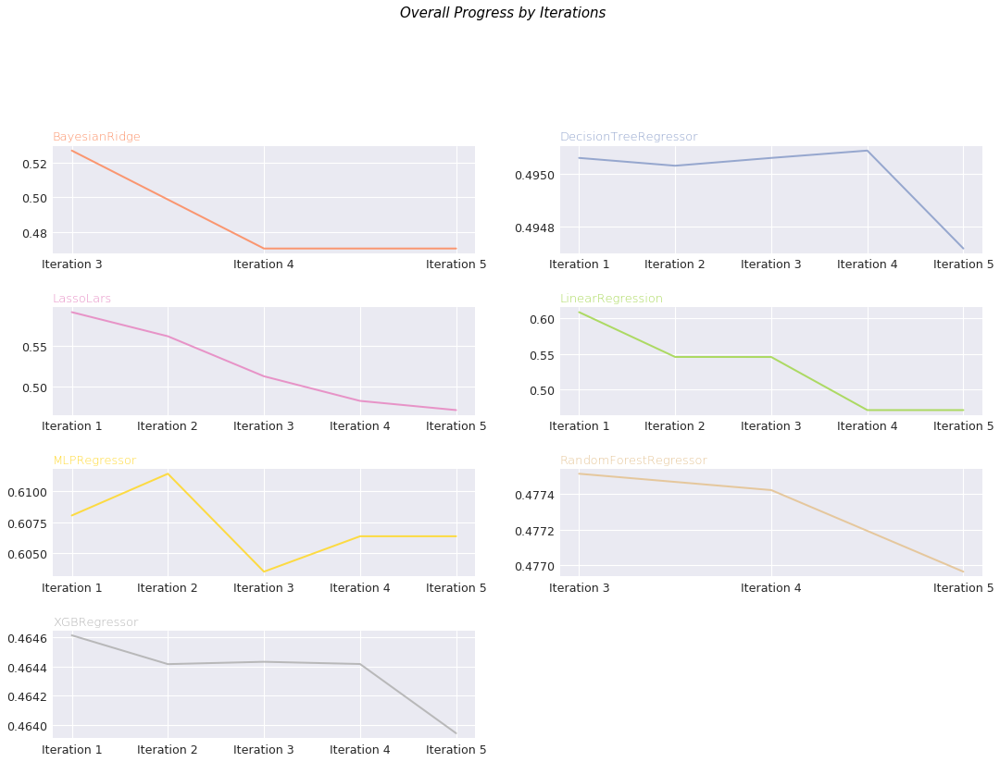

In [210]:
# Make a data frame
#df_tmp=pd.DataFrame({'x': range(1,11), 'y1': np.random.randn(10), 'y2': np.random.randn(10)+range(1,11), 'y3': np.random.randn(10)+range(11,21), 'y4': np.random.randn(10)+range(6,16), 'y5': np.random.randn(10)+range(4,14)+(0,0,0,0,0,0,0,-3,-8,-6), 'y6': np.random.randn(10)+range(2,12), 'y7': np.random.randn(10)+range(5,15), 'y8': np.random.randn(10)+range(4,14), 'y9': np.random.randn(10)+range(4,14) })

plt.style.use('seaborn-darkgrid') # Initialize the figure
plt.figure(figsize=(18,15))
plt.subplots_adjust(left=None, bottom=None, right=None, top=None, wspace=None, hspace=0.5)

palette = plt.get_cmap('Set2') # create a color palette
 
# multiple line plot
num=0
for column in df_tmp: #.drop('model_name', axis=1):
    num+=1 
    
    plt.subplot(5,2, num) # Find the right spot on the plot    
    plt.plot(df_tmp.index, df_tmp[column], marker='', color=palette(num), linewidth=2, alpha=0.9, label=column) # Plot the lineplot
    #plt.ylim(0.4,0.7) # Same limits for everybody! 
    plt.title(column, loc='left', fontsize=13, fontweight=0, color=palette(num) ) # Add sub title
 
# general title
plt.suptitle("Overall Progress by Iterations", fontsize=15, fontweight=0, color='black', style='italic', y=1.02)

#plt.text(0.9, 0.0, 'Iteration', ha='center', va='center')
#plt.text(0.06, 0.9, 'Score', ha='center', va='center', rotation='vertical') # Axis title

In [211]:
baseline_score=df_model_train_results[df_model_train_results.model_name=='LinearRegression'].grid_search_score.max()
baseline_score

0.6085313968000762

In [212]:
best_score=df_model_train_results.grid_search_score.min()
best_score

0.45764413325904296

In [213]:
improvement_ratio=100*(baseline_score-best_score)/baseline_score
improvement_ratio

24.795312835864237

In [120]:
var_notebook_end = time.time()
print(f"Kernel run time: {(var_notebook_end-var_notebook_start)/3600} hours or {(var_notebook_end-var_notebook_start)/60} minutes")

Kernel run time: 3.468567387726572 hours or 208.1140432635943 minutes


In [216]:
!!jupyter nbconvert *.ipynb

['[NbConvertApp] Converting notebook Basic_Version_v.1.0.ipynb to html',
 '[NbConvertApp] Writing 25346580 bytes to Basic_Version_v.1.0.html']